### Gerekli Kütüphaneler

In [79]:
import cv2
from PIL import Image, ImageFilter, ImageEnhance
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import shannon_entropy
from skimage.util import view_as_windows

### Görüntü Önişleme Aşamaları 

In [80]:
# Görseli işleyen fonksiyon
def process_image(image_path):
    # Görseli oku (OpenCV ile)
    image = cv2.imread(image_path)  # Görseli oku (OpenCV ile)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Görseli RGB formatına çevir (OpenCV BGR okur)

    # Gamma düzeltme fonksiyonu
    def gamma_correction(image, gamma):
        img_array = np.asarray(image) / 255.0  # Görseli [0,1] aralığına normalize et
        img_array = np.power(img_array, gamma)  # Gamma fonksiyonunu uygula
        img_array = np.clip(img_array * 255, 0, 255).astype(np.uint8)  # Görseli tekrar [0,255] aralığına döndür
        return img_array

    # Görseli gamma düzeltmesi ile işleyelim (gamma=2.0)
    img_gamma = gamma_correction(image_rgb, 2.0)

    # Renkli görseli gri tonlamaya çevir
    image_gray = cv2.cvtColor(img_gamma, cv2.COLOR_RGB2GRAY)

    # Pencerelerin boyutu (7x7)
    window_size = (7, 7)

    # Gri görseli küçük pencerelere ayır
    windows = view_as_windows(image_gray, window_size)

    # Standard sapma görseli oluşturmak için boş bir dizi
    std_image = np.zeros_like(image_gray, dtype=np.float32)

    # Her pencere için standard sapma hesapla
    for i in range(windows.shape[0]):
        for j in range(windows.shape[1]):
            window = windows[i, j]  # Pencereyi al
            std_value = np.std(window)  # Bu penceredeki standard sapmayı hesapla
            std_image[i, j] = std_value  # Hesaplanan standard sapmayı görsele yaz

    # Standard sapma görselini PIL formatına çevir
    std_image_pil = Image.fromarray(np.uint8(std_image))

    # Parlaklık ayarlama fonksiyonu
    def adjust_brightness(image, factor):
        image_rgb = np.stack([image] * 3, axis=-1)  # Görseli 3 kanallı yap (RGB)
        hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV)  # Görseli HSV renk uzayına çevir
        hsv = np.array(hsv, dtype=np.float64)  # HSV değerlerini float64 tipine çevir
        hsv[:,:,2] = np.clip(hsv[:,:,2] * factor, 0, 255)  # Parlaklık kanalını faktörle çarp ve sınırla
        return cv2.cvtColor(np.uint8(hsv), cv2.COLOR_HSV2RGB)  # Görseli tekrar RGB'ye çevir

    # Parlaklık artırma işlemi uygula
    img_bright = adjust_brightness(std_image_pil, 15)

    # Parlaklık eşikleme fonksiyonu
    def threshold_brightness(image, threshold):
        image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)  # Görseli gri tonlamaya çevir
        _, thresholded_image = cv2.threshold(image_gray, threshold, 255, cv2.THRESH_TOZERO)  # Eşikleme uygula
        return cv2.cvtColor(thresholded_image, cv2.COLOR_GRAY2RGB)  # Sonucu tekrar RGB'ye çevir

    # Eşikleme işlemi uygula (parlaklık 75'ın üstündeki pikselleri tut)
    img_bright_thresholded = threshold_brightness(img_bright, 75)

    # Görseli medyan bulanıklaştırma işlemi uygula
    img_bright_thresholded_blurred = cv2.medianBlur(img_bright_thresholded, 5)

    # Min-max normalizasyonu ile görseli yeniden ölçeklendir
    min_max_norm = cv2.normalize(img_bright_thresholded_blurred, None, 0, 255, cv2.NORM_MINMAX)

    return image_rgb, min_max_norm

### Görselin ve Labelin Eklenmesi, İşlenmiş Görsel.

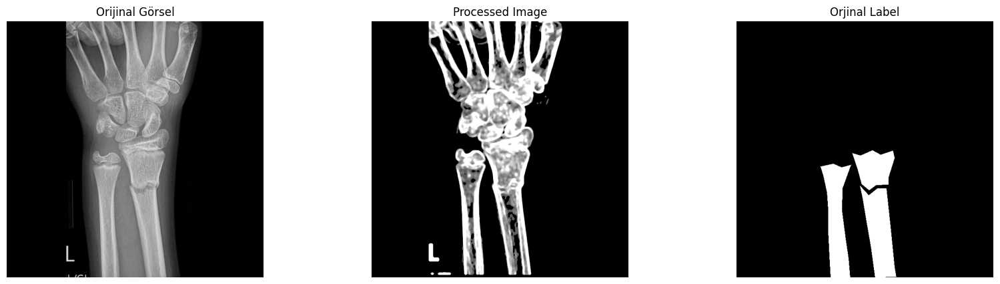

In [81]:
image_path = "DB/img3.png"
img, img_rgb = process_image(image_path)

label_path = "DB/label3.png"
label = cv2.imread(label_path)

# Sonuçları görselleştirmek için matplotlib ile göster
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

# Görselleri RGB formatında düzgün bir şekilde göster
axes[0].imshow(img)
axes[0].set_title("Orijinal Görsel")
axes[0].axis('off')

axes[1].imshow(np.array(img_rgb))
axes[1].set_title("Processed Image")
axes[1].axis('off')

axes[2].imshow(np.array(label))
axes[2].set_title("Orjinal Label")
axes[2].axis('off')

plt.show()

## Modelleme

### IOU Hesaplama

In [82]:
# IoU hesaplama fonksiyonu
def compute_iou(prediction, label):
    # Her iki görüntüyü ikili hale getirelim (0 ve 255)
    prediction_binary = prediction > 0
    label_binary = label > 0

    # Intersection ve Union hesapla
    intersection = np.sum(np.logical_and(prediction_binary, label_binary))
    union = np.sum(np.logical_or(prediction_binary, label_binary))

    # IoU hesapla
    iou = intersection / union if union != 0 else 0  # Eğer union 0 ise IoU'yu 0 olarak kabul et
    return iou

### HOG denemesi

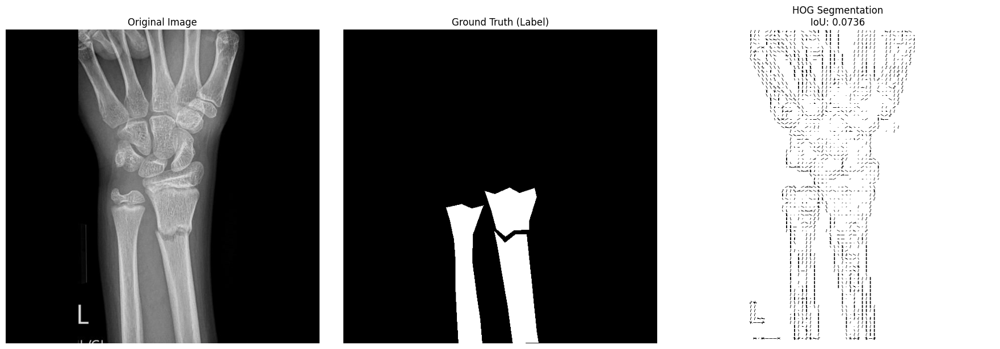

In [83]:
import cv2
import numpy as np
from skimage.feature import hog
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# HOG özelliklerini çıkarma
def extract_hog_features(image_gray):
    # HOG özelliklerini çıkar
    fd, hog_image = hog(image_gray, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)
    return fd, hog_image

# HOG özellikleriyle segmentasyon için K-means
def hog_kmeans_segmentation(image_gray, n_clusters=2):
    # HOG özelliklerini çıkar
    fd, hog_image = extract_hog_features(image_gray)

    # HOG özelliklerini 2D'ye dönüştür
    hog_image_resized = hog_image.reshape(-1, 1)

    # K-means ile kümelenme yap (n_clusters = 2)
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(hog_image_resized)

    # Kümeleme sonucu
    segmented_image = kmeans.predict(hog_image_resized).reshape(hog_image.shape)

    # Segmentasyonu ikili hale getir (0 ve 255 arasında)
    segmented_image = np.uint8(segmented_image * 255)

    return segmented_image

# IoU hesaplama fonksiyonu
def compute_iou(prediction, label):
    # Her iki görüntüyü ikili hale getirelim (0 ve 255)
    prediction_binary = prediction > 0
    label_binary = label > 0

    # Intersection ve Union hesapla
    intersection = np.sum(np.logical_and(prediction_binary, label_binary))
    union = np.sum(np.logical_or(prediction_binary, label_binary))

    # IoU hesapla
    iou = intersection / union if union != 0 else 0  # Eğer union 0 ise IoU'yu 0 olarak kabul et
    return iou

# HOG segmentasyonu için görseli gri tonlamaya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

# HOG segmentasyonu uygula
segmented_image = hog_kmeans_segmentation(img_gray)

# Etiket görselini yükle
label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

# IoU skorunu hesapla
iou_score = compute_iou(segmented_image, label_image)

# Sonuçları görselleştirme
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Orijinal Görsel
axes[0].imshow(img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Label Görseli
axes[1].imshow(label_image, cmap='gray')
axes[1].set_title('Ground Truth (Label)')
axes[1].axis('off')

# HOG Segmentasyonu ve IoU skoru
axes[2].imshow(segmented_image, cmap='gray')
axes[2].set_title(f'HOG Segmentation\nIoU: {iou_score:.4f}')
axes[2].axis('off')

plt.tight_layout()
plt.show()


### GMM Denemesi

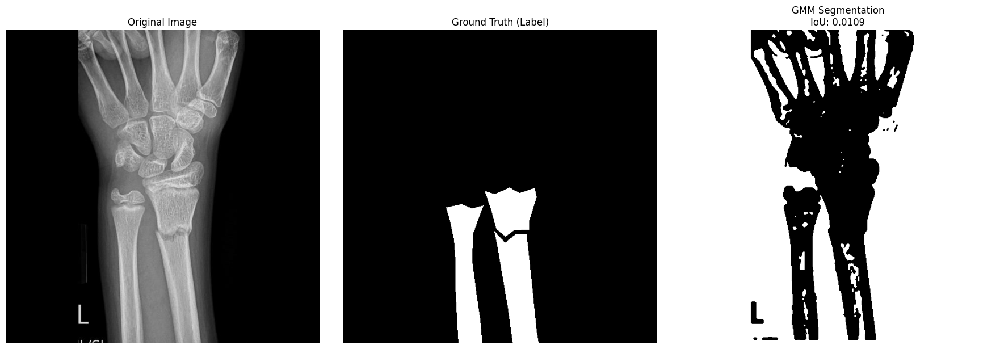

In [84]:
import cv2
import numpy as np
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# GMM ile kemik segmentasyonu
def gmm_segmentation(image_gray):
    # Görseli 2D olarak yeniden şekillendir
    image_reshaped = image_gray.reshape((-1, 1))

    # GMM modelini oluştur ve eğit
    gmm = GaussianMixture(n_components=2, covariance_type='full')
    gmm.fit(image_reshaped)

    # Görselin her pikselini GMM ile tahmin et
    segmented_image = gmm.predict(image_reshaped).reshape(image_gray.shape)

    # Segmentasyonu ikili hale getir (0 ve 255 arasında)
    segmented_image = np.uint8(segmented_image * 255)  # 0 ve 255 arasında ölçeklendir

    return segmented_image

# GMM segmentasyonu için görseli gri tonlamaya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

# GMM segmentasyonu uygula
segmented_image = gmm_segmentation(img_gray)

# Etiket görselini yükle
label_image = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

# IoU skorunu hesapla
iou_score = compute_iou(segmented_image, label_image)

# Sonuçları görselleştirme
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Orijinal Görsel
axes[0].imshow(img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Label Görseli
axes[1].imshow(label_image, cmap='gray')
axes[1].set_title('Ground Truth (Label)')
axes[1].axis('off')

# GMM Segmentasyonu ve IoU skoru
axes[2].imshow(segmented_image, cmap='gray')
axes[2].set_title(f'GMM Segmentation\nIoU: {iou_score:.4f}')
axes[2].axis('off')

plt.tight_layout()
plt.show()

### SIFT

Tespit edilen anahtar nokta sayısı: 962


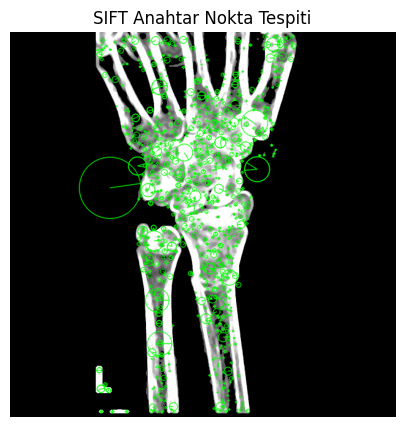

In [85]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü gri tonlamalıya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)

# SIFT detektörü oluştur
sift = cv2.SIFT_create()

# Anahtar noktaları ve tanımlayıcıları tespit et
keypoints, descriptors = sift.detectAndCompute(img_gray, None)

# Anahtar noktalarının sayısını yazdır
print(f"Tespit edilen anahtar nokta sayısı: {len(keypoints)}")

# Anahtar noktaları görüntüye çiz
img_keypoints = cv2.drawKeypoints(img_rgb, keypoints, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Görüntüyü matplotlib ile göster
plt.figure(figsize=(10, 5))
plt.imshow(cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB))  # OpenCV BGR formatını RGB'ye çeviriyoruz
plt.title("SIFT Anahtar Nokta Tespiti")
plt.axis('off')  # Eksenleri gizle
plt.show()


Label ile kesişen anahtar nokta sayısı: 260


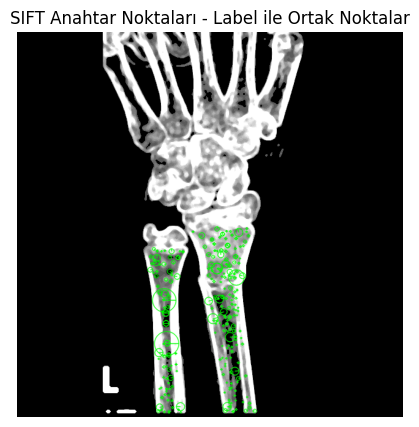

In [86]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü gri tonlamalıya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)
label = cv2.cvtColor(label, cv2.COLOR_BGR2GRAY)

# SIFT detektörü oluştur
sift = cv2.SIFT_create()

# Anahtar noktaları ve tanımlayıcıları tespit et
keypoints, descriptors = sift.detectAndCompute(img_gray, None)

# Label görüntüsündeki beyaz pikselleri (255 olanlar) alıyoruz
mask = (label == 255)

# Maskedeki (beyaz bölgelerdeki) anahtar noktalarını seçiyoruz
keypoints_in_label = [
    kp for kp in keypoints 
    if mask[int(kp.pt[1]), int(kp.pt[0])]  # y koordinatını int(kp.pt[1]) ve x koordinatını int(kp.pt[0]) olarak kontrol et
]

# Ortak noktaların sayısını yazdıralım
print(f"Label ile kesişen anahtar nokta sayısı: {len(keypoints_in_label)}")

# Ortak noktaları görüntüye çiz
img_keypoints_in_label = cv2.drawKeypoints(
    img_rgb, keypoints_in_label, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

# Görüntüyü matplotlib ile göster
plt.figure(figsize=(10, 5))
plt.imshow(cv2.cvtColor(img_keypoints_in_label, cv2.COLOR_BGR2RGB))  # OpenCV BGR formatını RGB'ye çeviriyoruz
plt.title("SIFT Anahtar Noktaları - Label ile Ortak Noktalar")
plt.axis('off')  # Eksenleri gizle
plt.show()


Label Kullanılarak oluşturulan SIFT

Tespit edilen anahtar nokta sayısı: 262


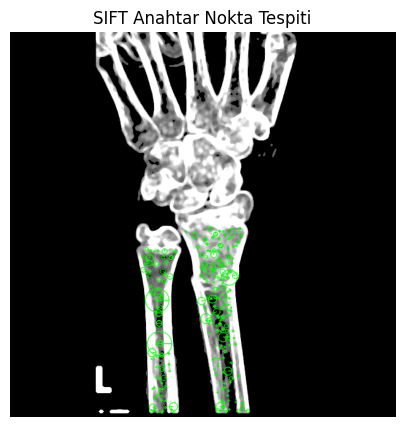

In [87]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü gri tonlamalıya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)

# Etiket görselinin 0 olmayan pikselleri maske olarak kullan
mask = label > 0  # Eğer label'da 0 olmayan pikseller varsa, bunlar maskelenecek bölgeler olacaktır
mask = np.uint8(mask)  # Maskeyi uint8 formatına çevir (0 ve 255 değerleri olacak)

# SIFT detektörü oluştur
sift = cv2.SIFT_create()

# Anahtar noktaları ve tanımlayıcıları tespit et, ancak sadece maskelenmiş bölgelerde
keypoints, descriptors = sift.detectAndCompute(img_gray, mask)

# Anahtar noktalarının sayısını yazdır
print(f"Tespit edilen anahtar nokta sayısı: {len(keypoints)}")

# Anahtar noktaları görüntüye çiz
img_keypoints = cv2.drawKeypoints(img_rgb, keypoints, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Görüntüyü matplotlib ile göster
plt.figure(figsize=(10, 5))
plt.imshow(cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB))  # OpenCV BGR formatını RGB'ye çeviriyoruz
plt.title("SIFT Anahtar Nokta Tespiti")
plt.axis('off')  # Eksenleri gizle
plt.show()


### Kenar Tespiti

#### Sobel

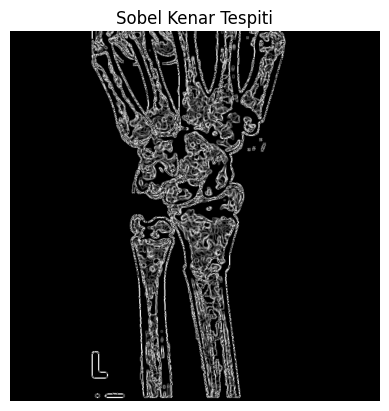

In [88]:
# Görseli gri tonlamaya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)

# Sobel operatörünü kullanarak kenar tespiti yapalım
# Sobel gradyanını yatay ve dikey olarak hesapla
sobel_x = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=3)  # X yönündeki gradyan (dikey kenarlar)
sobel_y = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=3)  # Y yönündeki gradyan (yatay kenarlar)

# X ve Y gradyanlarını birleştirerek toplam kenarları bul
sobel_edges = cv2.magnitude(sobel_x, sobel_y)

# Sonucu 0-255 aralığında görselleştir
sobel_edges = np.uint8(np.absolute(sobel_edges))

# Sonucu ekrana bastır
plt.imshow(sobel_edges, cmap='gray')
plt.title('Sobel Kenar Tespiti')
plt.axis('off')  # Eksenleri gizle
plt.show()


#### Canny

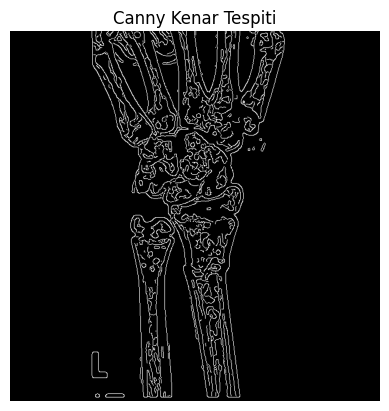

In [89]:
# Görseli gri tonlamaya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)

# Canny kenar tespiti uygula
edges = cv2.Canny(img_gray, 100, 200)  # Min ve Max eşik değerleri

# Sonucu ekrana bastır
plt.imshow(edges, cmap='gray')
plt.title('Canny Kenar Tespiti')
plt.axis('off')  # Eksenleri gizle
plt.show()


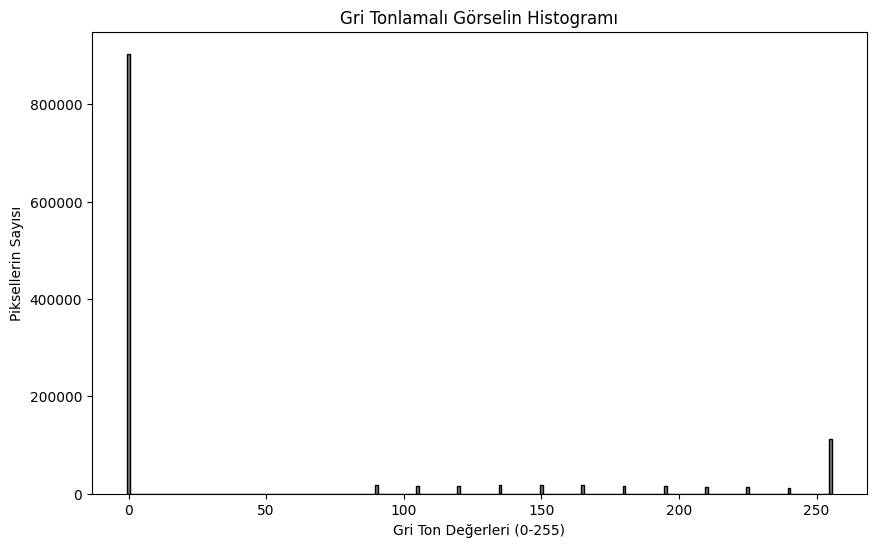

In [90]:
import matplotlib.pyplot as plt
import numpy as np

# img_rgb, işlenmiş gri tonlamalı görselinizin numpy array hali olmalı
# Örnek bir img_rgb oluşturmak için aşağıdaki satırı aktif edebilirsiniz:
# img_rgb = np.random.randint(0, 256, (256, 256), dtype=np.uint8)

# Görselin histogramını hesapla
hist, bins = np.histogram(img_rgb.flatten(), bins=256, range=(0, 256))

# Histogramı çiz
plt.figure(figsize=(10, 6))
plt.title("Gri Tonlamalı Görselin Histogramı")
plt.xlabel("Gri Ton Değerleri (0-255)")
plt.ylabel("Piksellerin Sayısı")
plt.bar(bins[:-1], hist, width=1, color='gray', edgecolor='black')
plt.show()


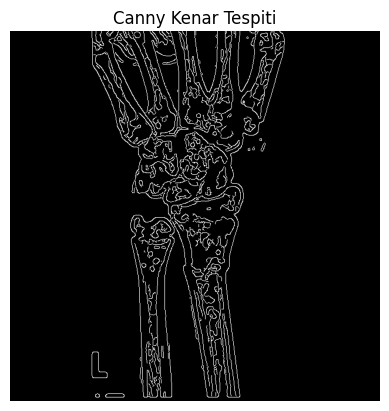

In [91]:
# Görseli gri tonlamaya çevir
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)

# Canny kenar tespiti uygula
edges = cv2.Canny(img_gray, 75, 250)  # Min ve Max eşik değerleri

# Sonucu ekrana bastır
plt.imshow(edges, cmap='gray')
plt.title('Canny Kenar Tespiti')
plt.axis('off')  # Eksenleri gizle
plt.show()


## Kenar desen kodlama denemesi

In [92]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
from PIL import Image, ImageFilter, ImageEnhance
from skimage.measure import shannon_entropy
from skimage.util import view_as_windows

# Görseli işleyen fonksiyon
def process_image(image_path):
    # Görseli oku (OpenCV ile)
    image = cv2.imread(image_path)  # Görseli oku (OpenCV ile)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Görseli RGB formatına çevir (OpenCV BGR okur)

    # Gamma düzeltme fonksiyonu
    def gamma_correction(image, gamma):
        img_array = np.asarray(image) / 255.0  # Görseli [0,1] aralığına normalize et
        img_array = np.power(img_array, gamma)  # Gamma fonksiyonunu uygula
        img_array = np.clip(img_array * 255, 0, 255).astype(np.uint8)  # Görseli tekrar [0,255] aralığına döndür
        return img_array

    # Görseli gamma düzeltmesi ile işleyelim (gamma=2.0)
    img_gamma = gamma_correction(image_rgb, 2.0)

    # Renkli görseli gri tonlamaya çevir
    image_gray = cv2.cvtColor(img_gamma, cv2.COLOR_RGB2GRAY)

    # Pencerelerin boyutu (7x7)
    window_size = (7, 7)

    # Gri görseli küçük pencerelere ayır
    windows = view_as_windows(image_gray, window_size)

    # Standard sapma görseli oluşturmak için boş bir dizi
    std_image = np.zeros_like(image_gray, dtype=np.float32)

    # Her pencere için standard sapma hesapla
    for i in range(windows.shape[0]):
        for j in range(windows.shape[1]):
            window = windows[i, j]  # Pencereyi al
            std_value = np.std(window)  # Bu penceredeki standard sapmayı hesapla
            std_image[i, j] = std_value  # Hesaplanan standard sapmayı görsele yaz

    # Standard sapma görselini PIL formatına çevir
    std_image_pil = Image.fromarray(np.uint8(std_image))

    # Parlaklık ayarlama fonksiyonu
    def adjust_brightness(image, factor):
        image_rgb = np.stack([image] * 3, axis=-1)  # Görseli 3 kanallı yap (RGB)
        hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV)  # Görseli HSV renk uzayına çevir
        hsv = np.array(hsv, dtype=np.float64)  # HSV değerlerini float64 tipine çevir
        hsv[:,:,2] = np.clip(hsv[:,:,2] * factor, 0, 255)  # Parlaklık kanalını faktörle çarp ve sınırla
        return cv2.cvtColor(np.uint8(hsv), cv2.COLOR_HSV2RGB)  # Görseli tekrar RGB'ye çevir

    # Parlaklık artırma işlemi uygula
    img_bright = adjust_brightness(std_image_pil, 15)

    # Parlaklık eşikleme fonksiyonu
    def threshold_brightness(image, threshold):
        image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)  # Görseli gri tonlamaya çevir
        _, thresholded_image = cv2.threshold(image_gray, threshold, 255, cv2.THRESH_TOZERO)  # Eşikleme uygula
        return cv2.cvtColor(thresholded_image, cv2.COLOR_GRAY2RGB)  # Sonucu tekrar RGB'ye çevir

    # Eşikleme işlemi uygula (parlaklık 75'ın üstündeki pikselleri tut)
    img_bright_thresholded = threshold_brightness(img_bright, 75)

    # Görseli medyan bulanıklaştırma işlemi uygula
    img_bright_thresholded_blurred = cv2.medianBlur(img_bright_thresholded, 5)

    # Min-max normalizasyonu ile görseli yeniden ölçeklendir
    min_max_norm = cv2.normalize(img_bright_thresholded_blurred, None, 0, 255, cv2.NORM_MINMAX)

    return image_rgb, min_max_norm

def Draw(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    return output_img

def GetImageLabel(imgStr,labelStr,draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img) # print(img.max())
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        # Görüntü ve etiketleri yan yana çiz
        plt.figure(figsize=(12, 6))  # Şekil boyutunu ayarla
        plt.subplot(1, 2, 1)  # 1 satır, 2 sütun, ilk eksen
        plt.imshow(img, cmap='gray')  # img görüntüsünü göster
        plt.title(imgStr)  # Başlık
        plt.axis('off')  # Eksenleri kapat
        
        plt.subplot(1, 2, 2)  # 1 satır, 2 sütun, ikinci eksen
        plt.imshow(label, cmap='gray')  # label görüntüsünü göster
        plt.title(labelStr)  # Başlık
        plt.axis('off')  # Eksenleri kapat
        
        plt.tight_layout()
        plt.show()  # Şekli göster        
    return img, label

def ConvertAndNormalize(img):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Görüntüyü normalize et (0-255 aralığına getir)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    
    return normalized_img

def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()                

def GetLabelEdgePoints(img, sparsity_factor=1, circle_radius = 10, draw=False):
    contours = measure.find_contours(img, level=0.5)
    # Tüm sınır piksellerini birleştir
    boundary_points = np.vstack(contours)
    
    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        boundary_points = boundary_points[::sparsity_factor]
        
    if draw:
        Drawing(img, EdgePoints=boundary_points, circle_radius=circle_radius)

    return boundary_points.astype(int)

def GetCannyEdgePoints(img, sparsity_factor=1, draw=False):
    blurimg = cv2.GaussianBlur(img, (5, 5), 0)
    edges = cv2.Canny(blurimg, 50, 150)
    CannyEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in CannyEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    return EdgePoints

def EuclidDistance(point1,point2):
    y1,x1 = point1
    y2,x2 = point2        
    return int(np.sqrt((x1-x2)**2 + (y1-y2)**2))

def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo

def DisplayPatches(EdgePatchs, max_cols=10):
    # Toplam patch sayısı
    num_patches = len(EdgePatchs)
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()

from skimage.feature import hog
from skimage import exposure

def EdgePatchs2EdgeVecs(EdgePatchs, draw=False, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=False):
    EdgeVecs = []
    
    for img in EdgePatchs:
        img = img.astype(np.float32)
        
        # HOG özelliklerini çıkar
        if visualize:
            features, hog_image = hog(img, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, visualize=True)
        else:
            features = hog(img, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, visualize=False)
        
        # Eğer görselleştirme yapılacaksa, HOG görselleştirmesi
        if visualize:
            # Normalize HOG görselleştirmesi
            hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
            plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
            plt.title("HOG Features")
            plt.show()
        
        EdgeVecs.append(features)

    EdgeVecs = np.squeeze(np.array(EdgeVecs))
    
    if draw:
        print("EdgeVecs boyutu:", EdgeVecs.shape)

    return EdgeVecs


def FindUniqueVectors(vectors, threshold=10):
    unique_indices = []
    for i, vector in enumerate(vectors):
        is_unique = True
        for j in unique_indices:
            if np.linalg.norm(vector - vectors[j]) < threshold:
                is_unique = False
                break
        if is_unique:
            unique_indices.append(i)
    return unique_indices

def GetUniquePatchsVectors(EdgePatchs, EdgeVecs, UniqueInds, draw=False):
    Patchs = []
    Vectors = []
    for idx in UniqueInds:
            Patchs.append(EdgePatchs[idx])
            Vectors.append(EdgeVecs[idx])
    Vectors = np.squeeze(np.array(Vectors))    
    if draw:
        DisplayPatches(Patchs)
        print("Vectors Size:", Vectors.shape)

    return Patchs, Vectors

def cosine_similarity(vec1, vec2):
    dot_product = np.dot(vec1, vec2)
    norm_vec1 = np.linalg.norm(vec1)
    norm_vec2 = np.linalg.norm(vec2)
    return dot_product / (norm_vec1 * norm_vec2)

def Match(img_UniqueVecs, test_img_EdgeVecs, test_img_EdgePoints, threshold=10):
    TrueEdgePoints = []
    for i, test_vec in enumerate(test_img_EdgeVecs):
        similarities = [np.linalg.norm(test_vec - unique_vec) for unique_vec in img_UniqueVecs]        
        #similarities = [cosine_similarity(test_vec - unique_vec) for unique_vec in img_UniqueVecs]        
        if max(similarities) >= threshold:
            TrueEdgePoints.append(test_img_EdgePoints[i])

    return TrueEdgePoints

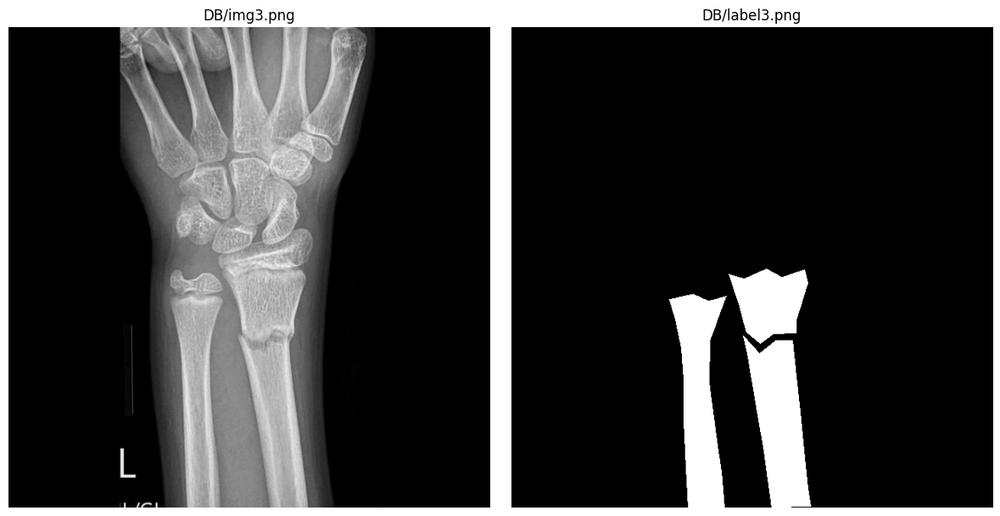

In [93]:
img, label = GetImageLabel('DB/img3.png','DB/label3.png',draw=True)

In [116]:
# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=100, circle_radius=10, draw=False)   # EdgePoints --> [p,2] --> (y,x)

/tmp/ipykernel_6093/2123427600.py:170: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


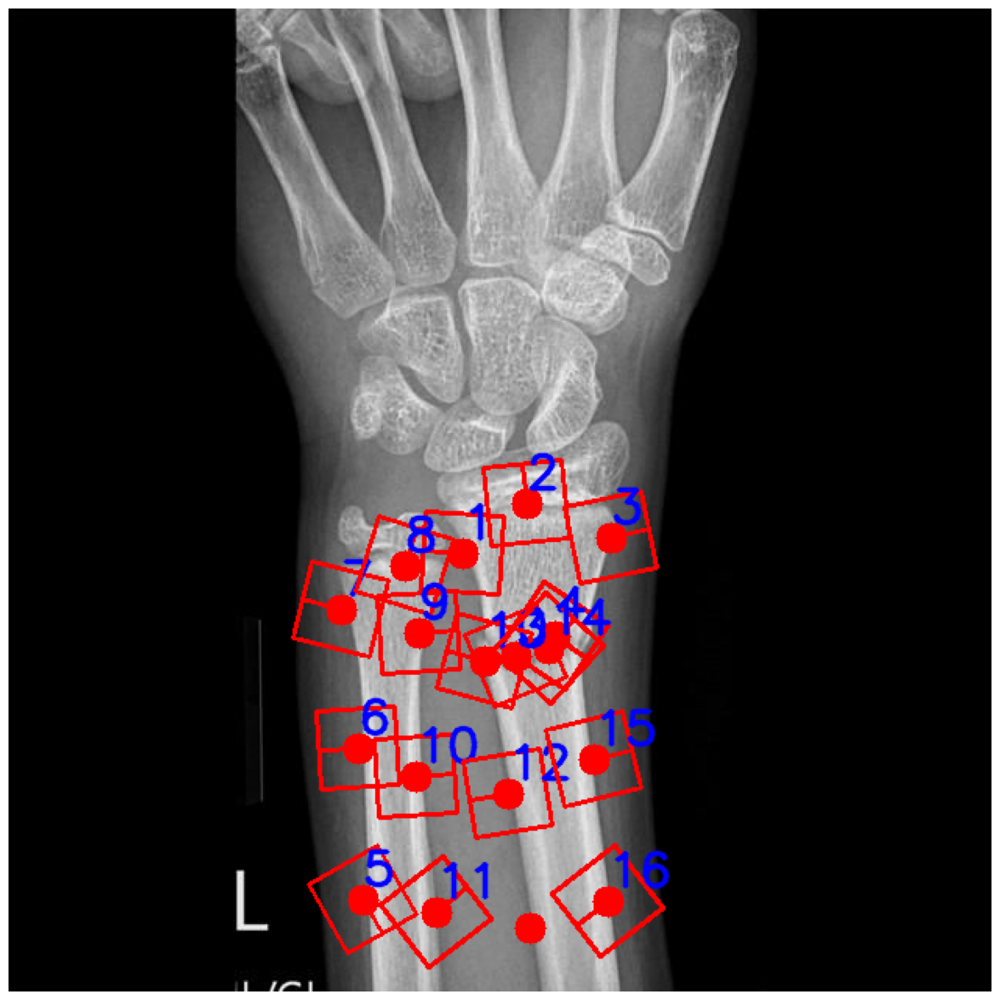

In [95]:
# img_EdgePoints --> img_EdgePatchs 
img_EdgePatchs, img_EdgePatchsInfo = GetEdgePatchs(img, img_EdgePoints, PatchSize=50, draw=True)  # M = 2*PatchSize + 1,  MxM = 101x101

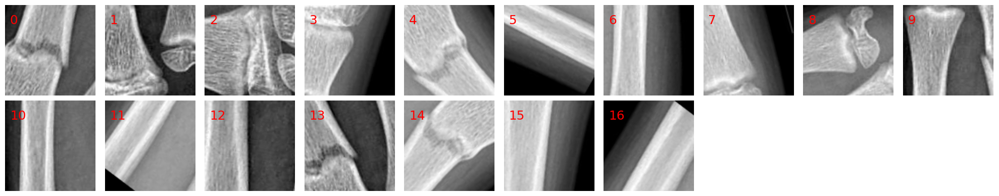

In [96]:
# img_EdgePatchs gorsellerini tek figurede gor (donmusmuyu kontrol et)
DisplayPatches(img_EdgePatchs)

In [97]:
# ImgEdgePatchs --> ImgEdgeVecs
img_EdgeVecs = EdgePatchs2EdgeVecs(img_EdgePatchs, draw=True)

EdgeVecs boyutu: (17, 4356)


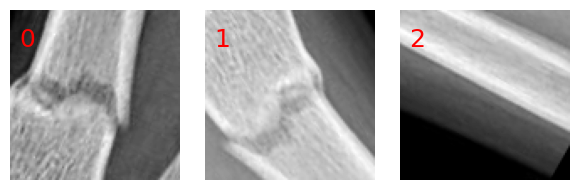

Vectors Size: (3, 4356)


In [98]:
# Farkli olan Patch ve onun Vec verisini tut
UniqueInds = FindUniqueVectors(img_EdgeVecs)
img_UniquePatchs, img_UniqueVecs = GetUniquePatchsVectors(img_EdgePatchs, img_EdgeVecs, UniqueInds, draw=True)

## Test

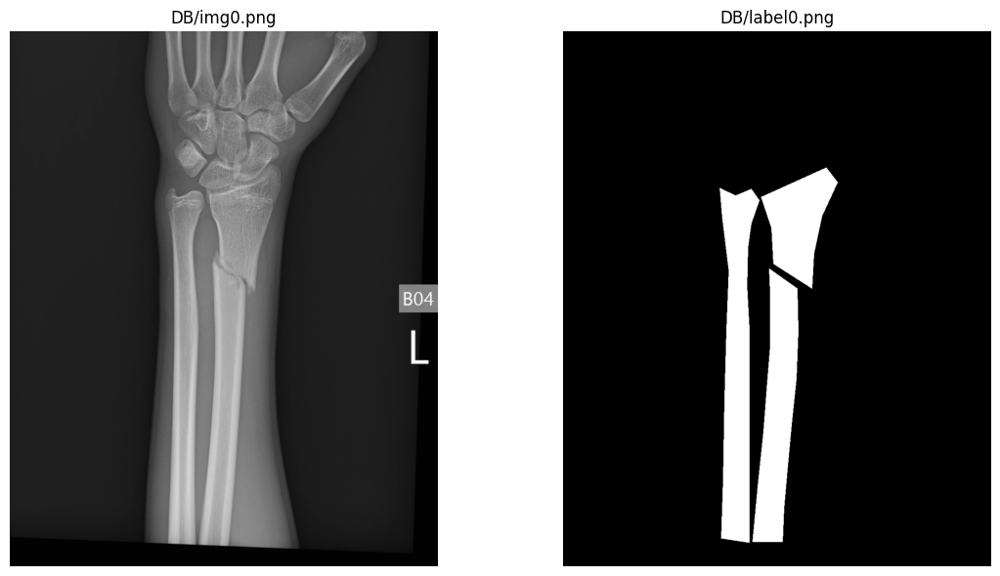

In [99]:
test_img, test_label = GetImageLabel('DB/img0.png','DB/label0.png',draw=True)

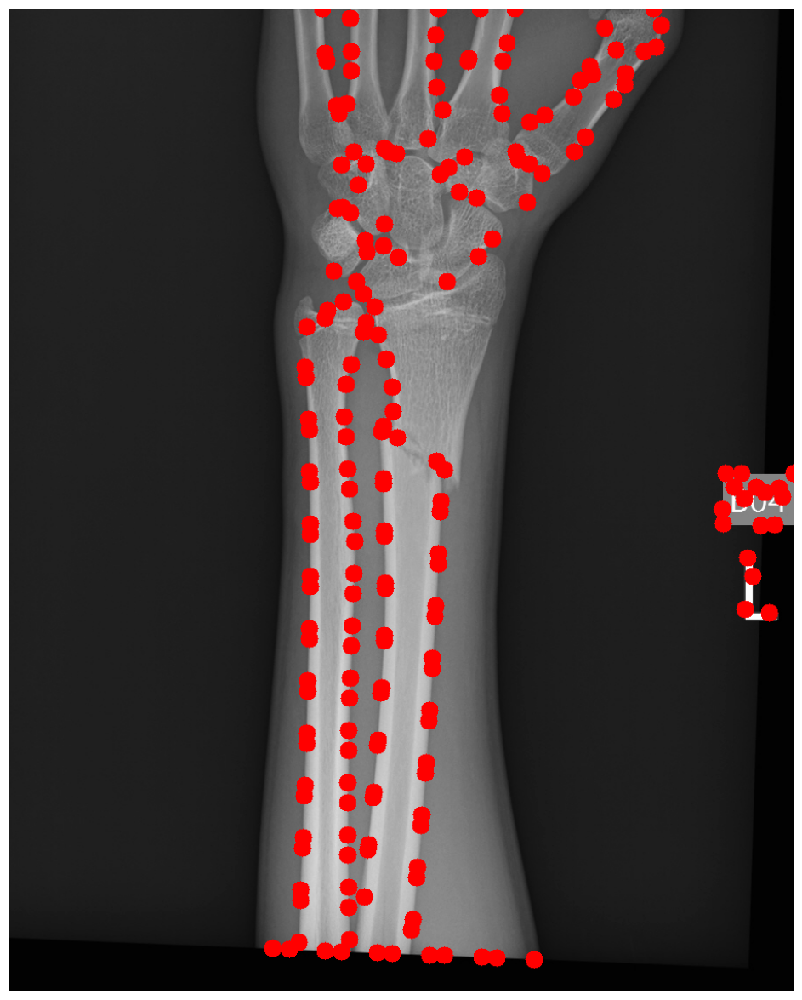

In [112]:
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=60, draw=True)   # EdgePoints --> [p,2] --> (y,x)

/tmp/ipykernel_6093/2123427600.py:170: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


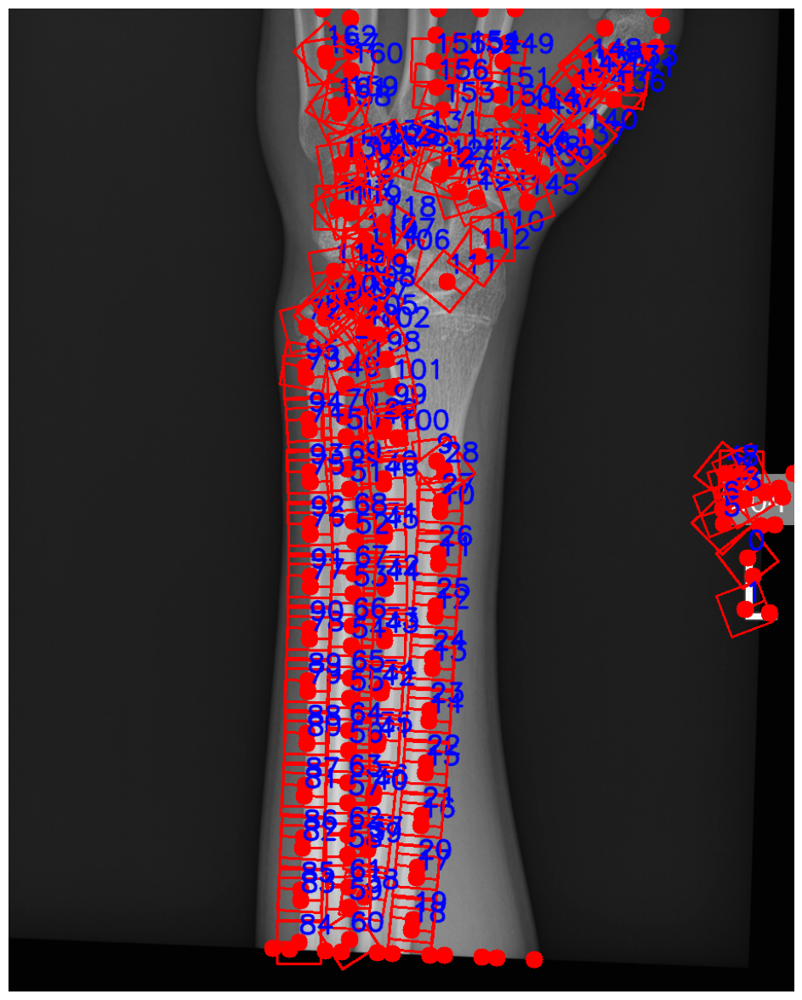

In [101]:
test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=50, draw=True)

In [102]:
test_img_EdgeVecs = EdgePatchs2EdgeVecs(test_img_EdgePatchs, draw=True)

EdgeVecs boyutu: (163, 4356)


In [103]:
TrueEdgePoints = Match(img_UniqueVecs, test_img_EdgeVecs, test_img_EdgePoints)

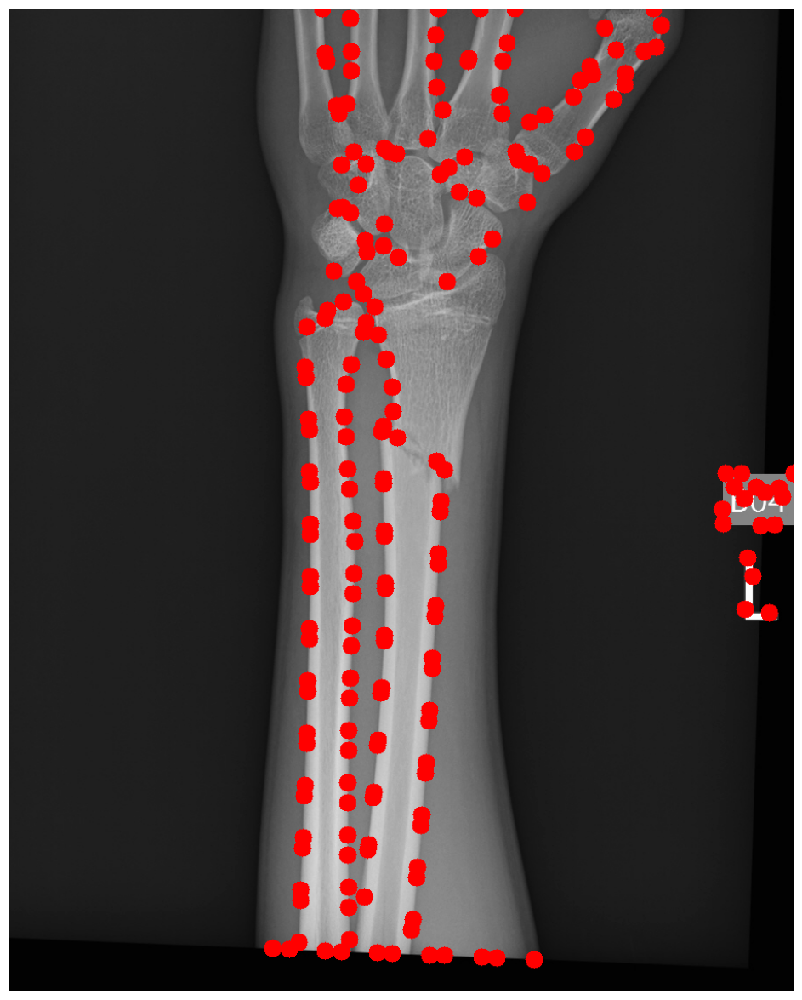

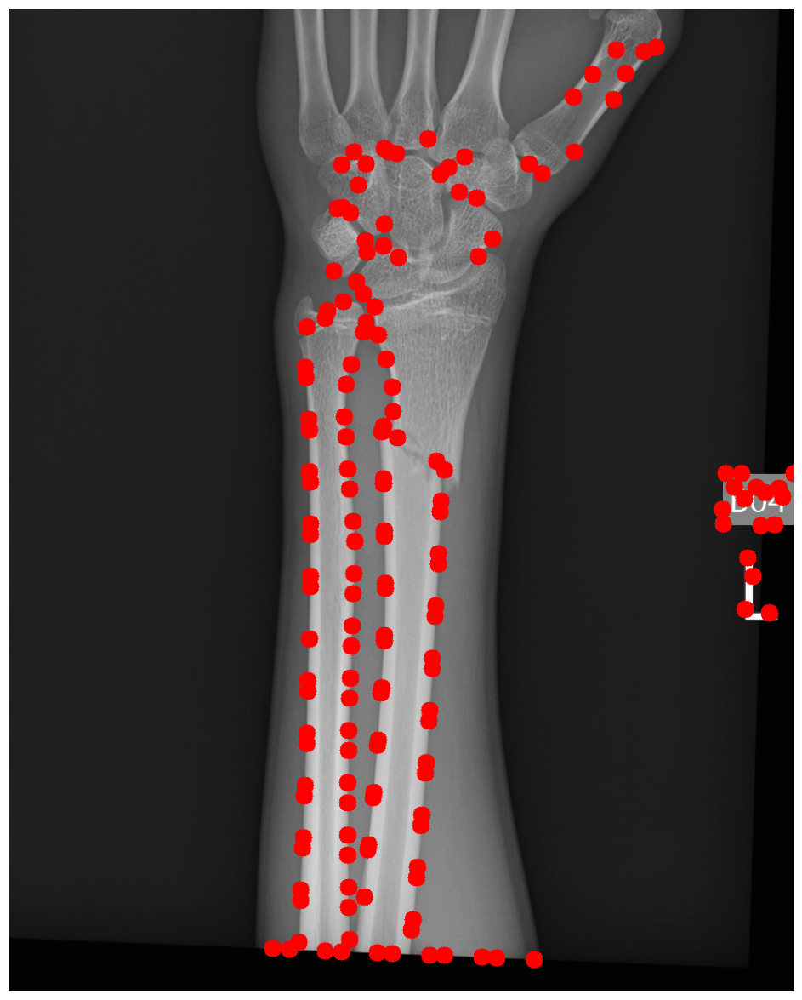

In [104]:
Drawing(test_img, EdgePoints=test_img_EdgePoints)

Drawing(test_img, EdgePoints=TrueEdgePoints)

cv2.fillPoly fonksiyonu ile maske bulma

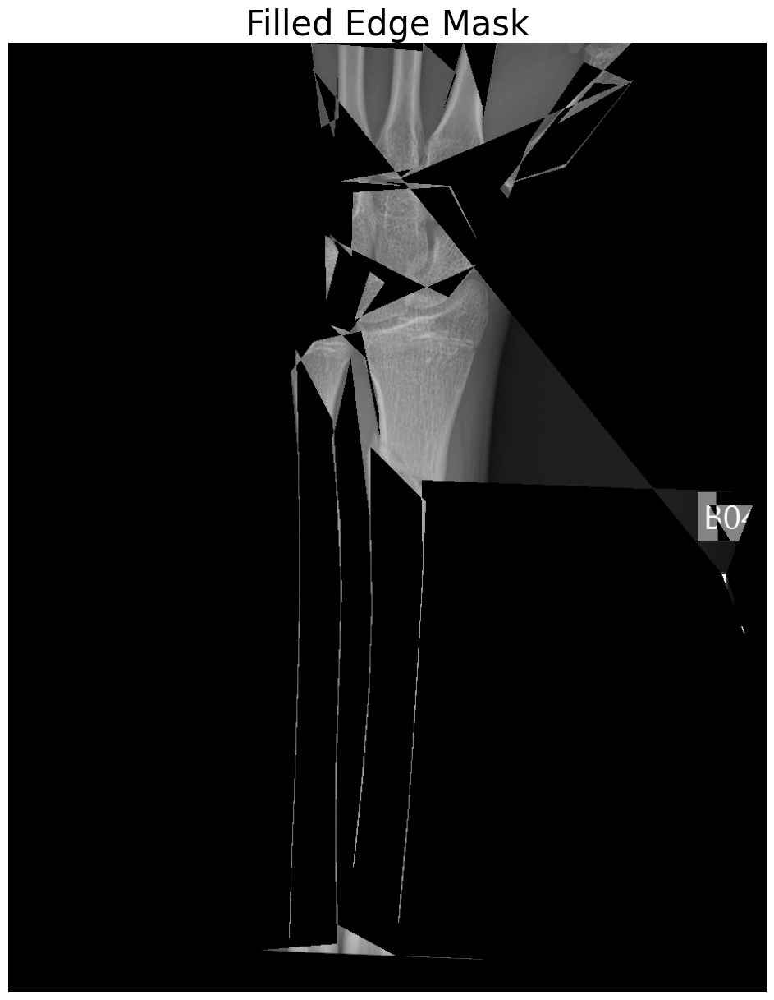

In [105]:
def ApplyFilledEdgeMask(img, EdgePoints, radius=1):
    """
    Kenar noktalarını birleştirip poligon oluşturur ve bu poligonun içini doldurur.
    :param img: İşlenecek gri tonlamalı görüntü.
    :param EdgePoints: Kenar noktaları listesi (y, x).
    :param radius: Noktalar arasındaki mesafeyi artıracak bir parametre.
    :return: Poligonun içini doldurulmuş maske.
    """
    # Boş bir maske oluştur (ilk başta tüm pikseller siyah olacak)
    mask = np.zeros_like(img, dtype=np.uint8)
    
    # Kenar noktalarını etrafında bir çevre çizin (noktalar etrafında küçük daireler çizerek)
    points = []
    for point in EdgePoints:
        y, x = point  # EdgePoint'ten (y, x) koordinatlarını al
        points.append((x, y))  # Noktaları bir listeye ekle
    
    # Noktaları birleştirip poligon oluşturuyoruz
    points = np.array(points, dtype=np.int32)
    
    # Poligonun içini doldur
    cv2.fillPoly(mask, [points], 255)

    # Maskeyi orijinal görsele uygulayarak sadece kenarları bırak
    masked_img = cv2.bitwise_and(img, mask)

    return masked_img

# Kenar noktalarını al
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=100, draw=False)  # (y, x) formatında

# Maskeyi uygula
masked_img = ApplyFilledEdgeMask(test_img, test_img_EdgePoints, radius=3)

# Sonucu çiz
Drawing(masked_img, title="Filled Edge Mask")

cv2.convexHull fonksiyonu ile düzenlenip cv2.fillPoly fonksiyonu ile maske bulma

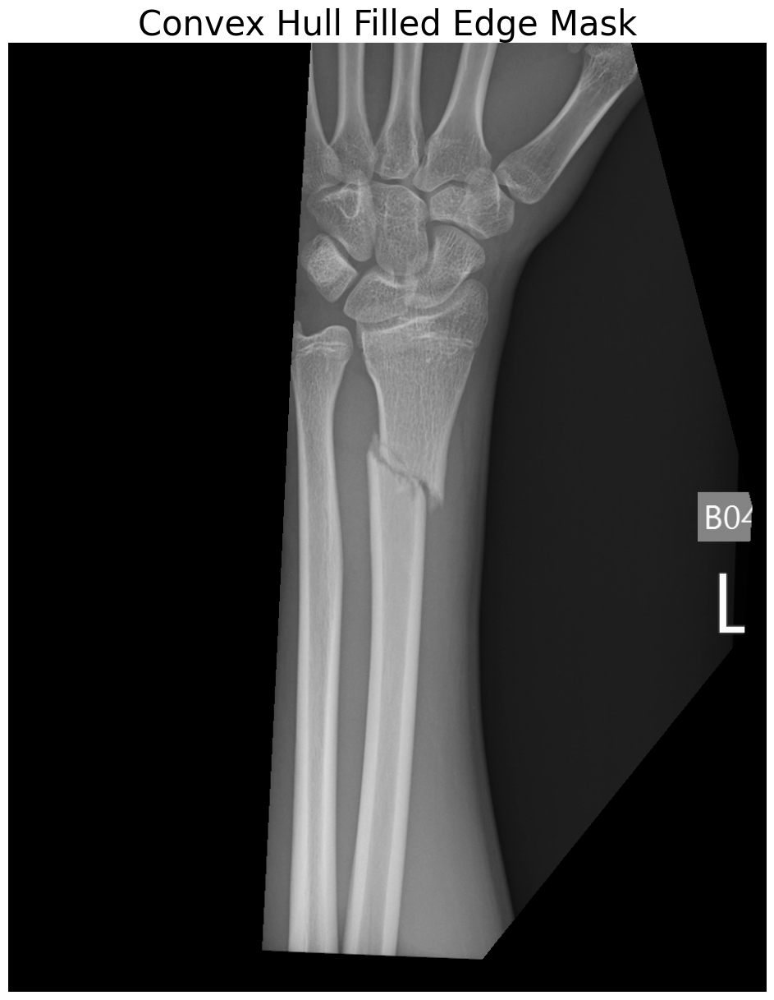

In [106]:
def ApplyConvexHullEdgeMask(img, EdgePoints, radius=1):
    """
    Kenar noktalarından Konveks Hull poligonu oluşturur ve bu poligonun içini doldurur.
    :param img: İşlenecek gri tonlamalı görüntü.
    :param EdgePoints: Kenar noktaları listesi (y, x).
    :param radius: Noktalar arasındaki mesafeyi artıracak bir parametre.
    :return: Konveks Hull poligonunun içini doldurulmuş maske.
    """
    # Boş bir maske oluştur (ilk başta tüm pikseller siyah olacak)
    mask = np.zeros_like(img, dtype=np.uint8)
    
    # Kenar noktalarını etrafında bir çevre çizin (noktalar etrafında küçük daireler çizerek)
    points = []
    for point in EdgePoints:
        y, x = point  # EdgePoint'ten (y, x) koordinatlarını al
        points.append((x, y))  # Noktaları bir listeye ekle
    
    # Noktaları birleştirip konveks hull (dış sınır) oluştur
    points = np.array(points, dtype=np.int32)
    hull = cv2.convexHull(points)  # Kenar noktaları etrafında konveks hull oluştur
    
    # Konveks hull'un içini doldur
    cv2.fillPoly(mask, [hull], 255)

    # Maskeyi orijinal görsele uygulayarak sadece kenarları bırak
    masked_img = cv2.bitwise_and(img, mask)

    return masked_img

# Kenar noktalarını al
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=100, draw=False)  # (y, x) formatında

# Maskeyi uygula
masked_img = ApplyConvexHullEdgeMask(test_img, test_img_EdgePoints, radius=3)

# Sonucu çiz
Drawing(masked_img, title="Convex Hull Filled Edge Mask")


Maskeye erozyon ve temizleme ekleme

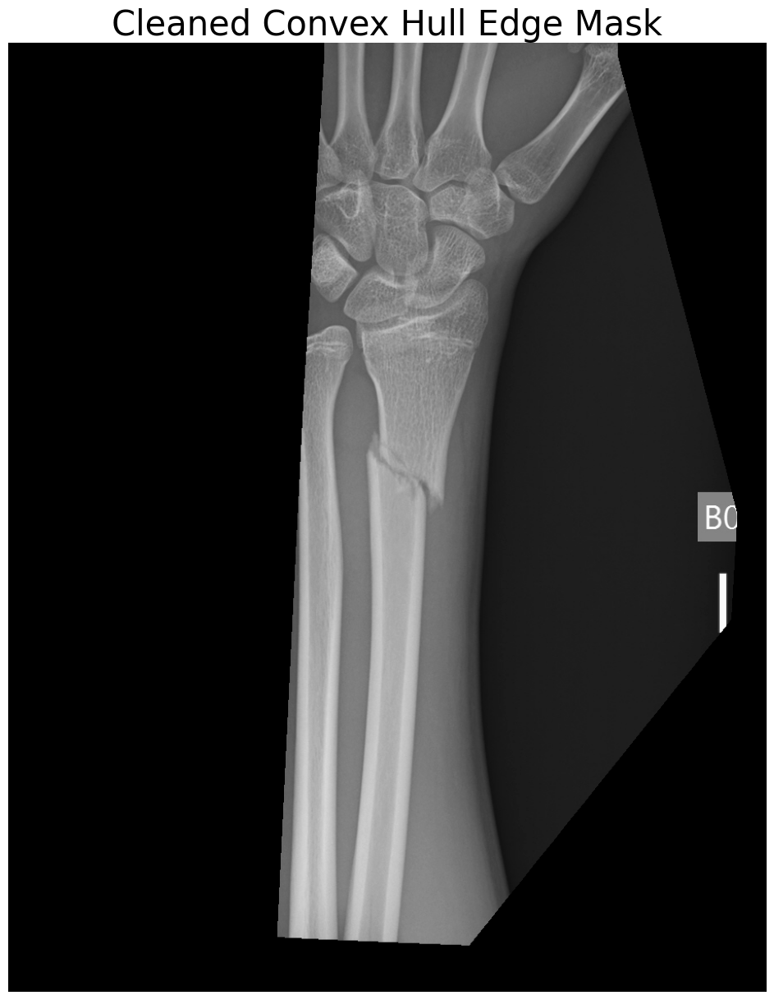

In [107]:
def ApplyConvexHullEdgeMaskWithCleanup(img, EdgePoints, radius=1, min_area=500):
    """
    Kenar noktalarından Konveks Hull poligonu oluşturur ve fazla alanları temizler.
    :param img: İşlenecek gri tonlamalı görüntü.
    :param EdgePoints: Kenar noktaları listesi (y, x).
    :param radius: Noktalar arasındaki mesafeyi artıracak bir parametre.
    :param min_area: Tutulacak alanın minimum büyüklüğü.
    :return: Temizlenmiş maskelenmiş görsel.
    """
    # Boş bir maske oluştur (ilk başta tüm pikseller siyah olacak)
    mask = np.zeros_like(img, dtype=np.uint8)
    
    # Kenar noktalarını etrafında bir çevre çizin (noktalar etrafında küçük daireler çizerek)
    points = []
    for point in EdgePoints:
        y, x = point  # EdgePoint'ten (y, x) koordinatlarını al
        points.append((x, y))  # Noktaları bir listeye ekle
    
    # Noktaları birleştirip konveks hull (dış sınır) oluştur
    points = np.array(points, dtype=np.int32)
    hull = cv2.convexHull(points)  # Kenar noktaları etrafında konveks hull oluştur
    
    # Konveks hull'un içini doldur
    cv2.fillPoly(mask, [hull], 255)

    # Fazlalık alanları temizlemek için maske üzerinde erozyon uygula
    mask = cv2.erode(mask, None, iterations=16)

    # Maskeyi orijinal görsele uygulayarak sadece kenarları bırak
    masked_img = cv2.bitwise_and(img, mask)

    # Kontur bulma ve küçük alanları temizleme
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    clean_mask = np.zeros_like(mask)
    
    for contour in contours:
        if cv2.contourArea(contour) > min_area:
            cv2.drawContours(clean_mask, [contour], -1, 255, thickness=cv2.FILLED)

    # Temizlenmiş maskeyi orijinal görsele uygula
    final_masked_img = cv2.bitwise_and(img, clean_mask)

    return final_masked_img, clean_mask

# Kenar noktalarını al
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=100, draw=False)  # (y, x) formatında

# Maskeyi uygula ve temizle
masked_img, maske = ApplyConvexHullEdgeMaskWithCleanup(test_img, test_img_EdgePoints, radius=3, min_area=500)

# Sonucu çiz
Drawing(masked_img, title="Cleaned Convex Hull Edge Mask")


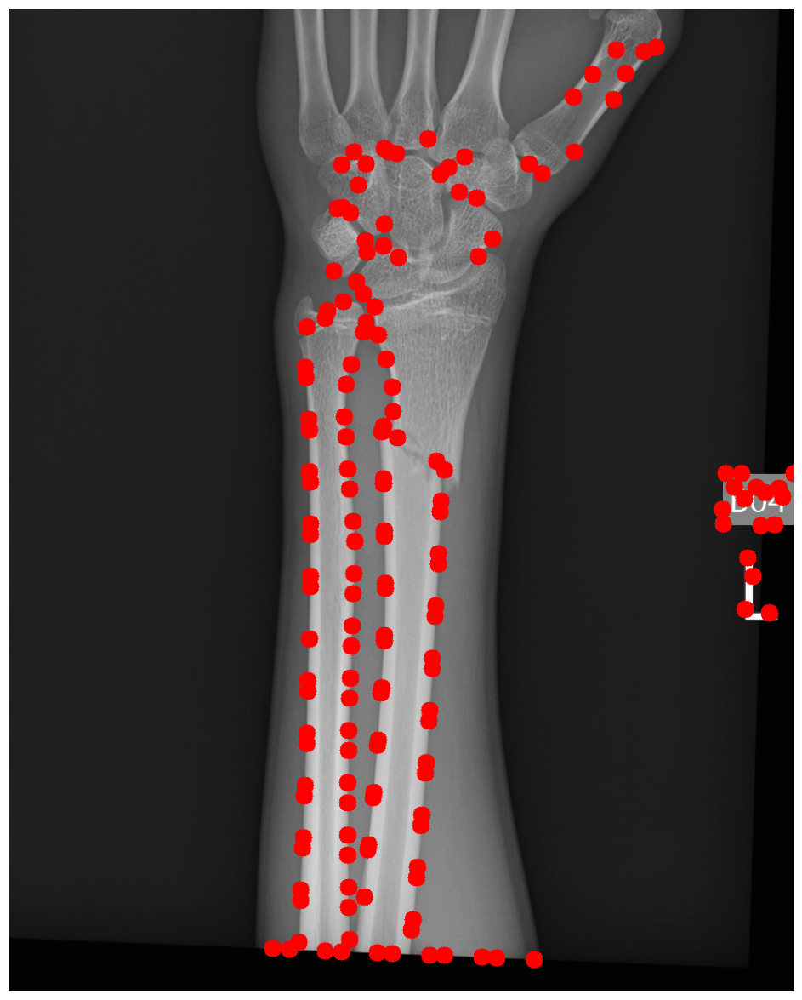

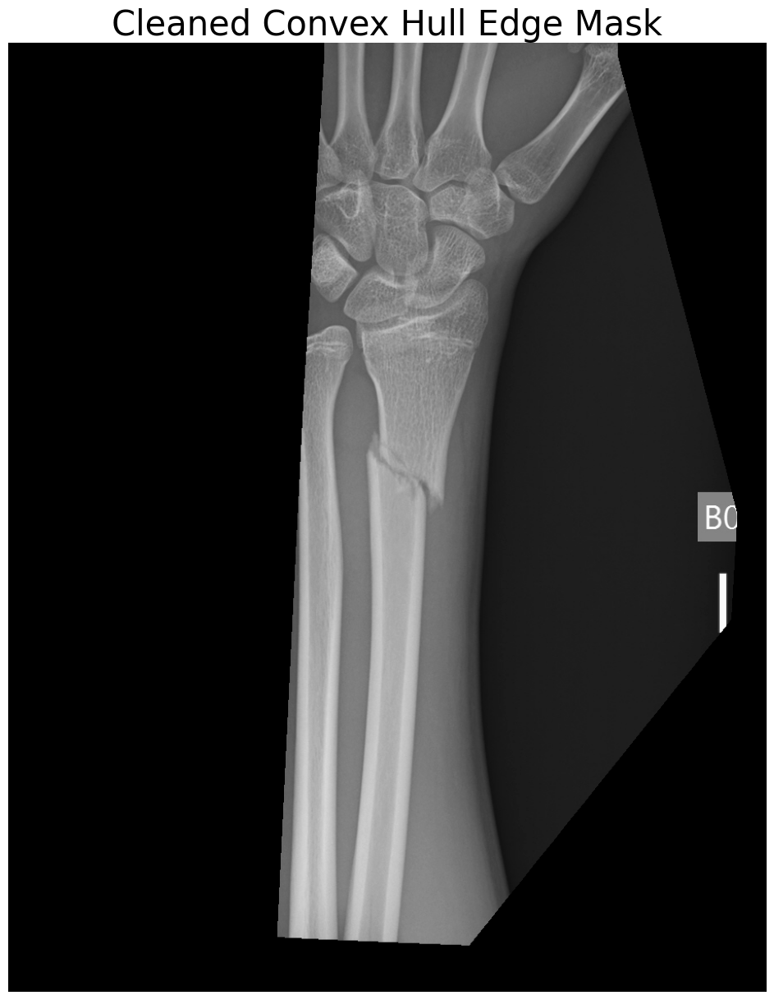

In [113]:
test_img, test_label = GetImageLabel('DB/img0.png','DB/label0.png',draw=False)
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=60, draw=False)   # EdgePoints --> [p,2] --> (y,x)
test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=50, draw=False)
test_img_EdgeVecs = EdgePatchs2EdgeVecs(test_img_EdgePatchs, draw=False)
TrueEdgePoints = Match(img_UniqueVecs, test_img_EdgeVecs, test_img_EdgePoints)
Drawing(test_img, EdgePoints=TrueEdgePoints)

# Kenar noktalarını al
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=100, draw=False)  # (y, x) formatında

# Maskeyi uygula ve temizle
masked_img, maske = ApplyConvexHullEdgeMaskWithCleanup(test_img, test_img_EdgePoints, radius=3, min_area=500)

# Sonucu çiz
Drawing(masked_img, title="Cleaned Convex Hull Edge Mask")

### 10 görsel denemesi

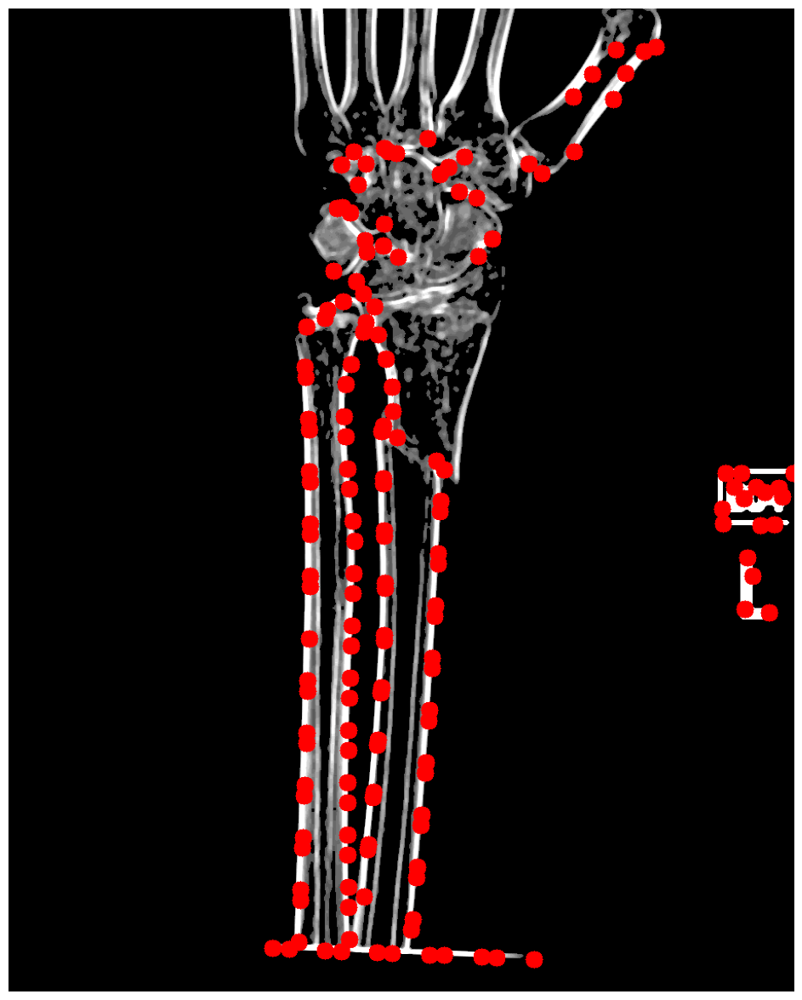

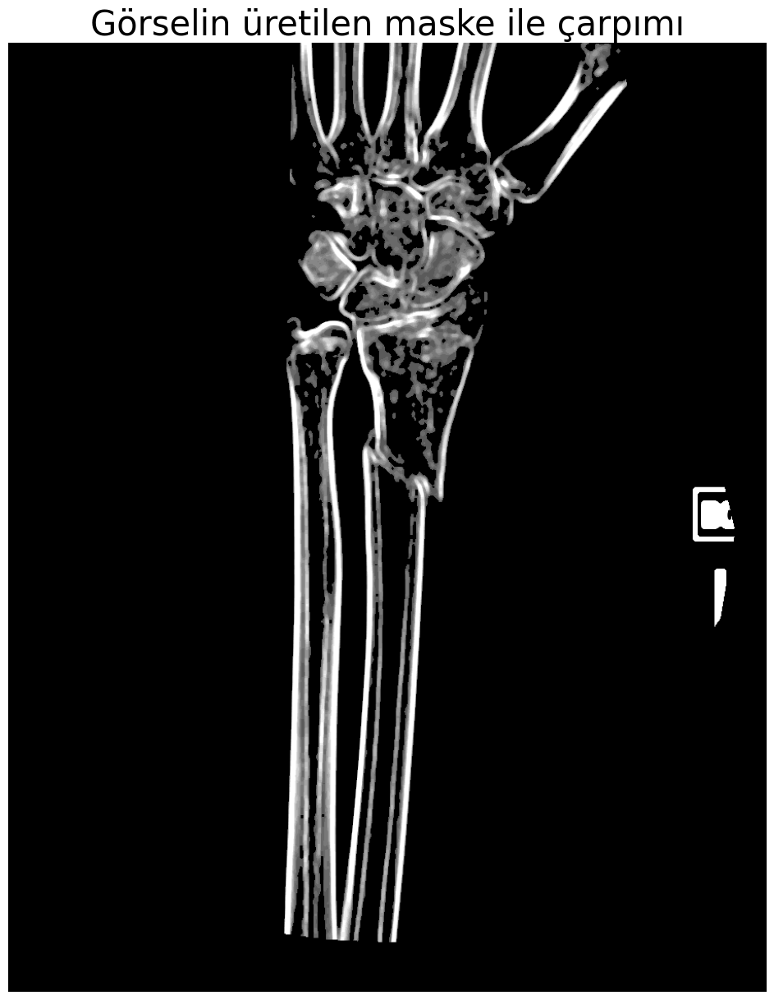

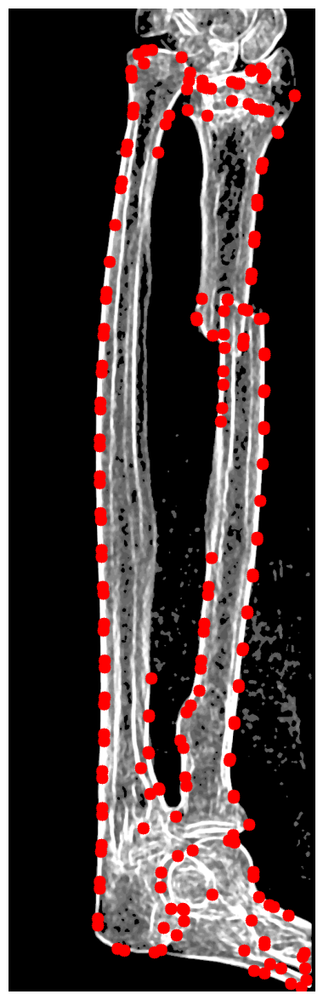

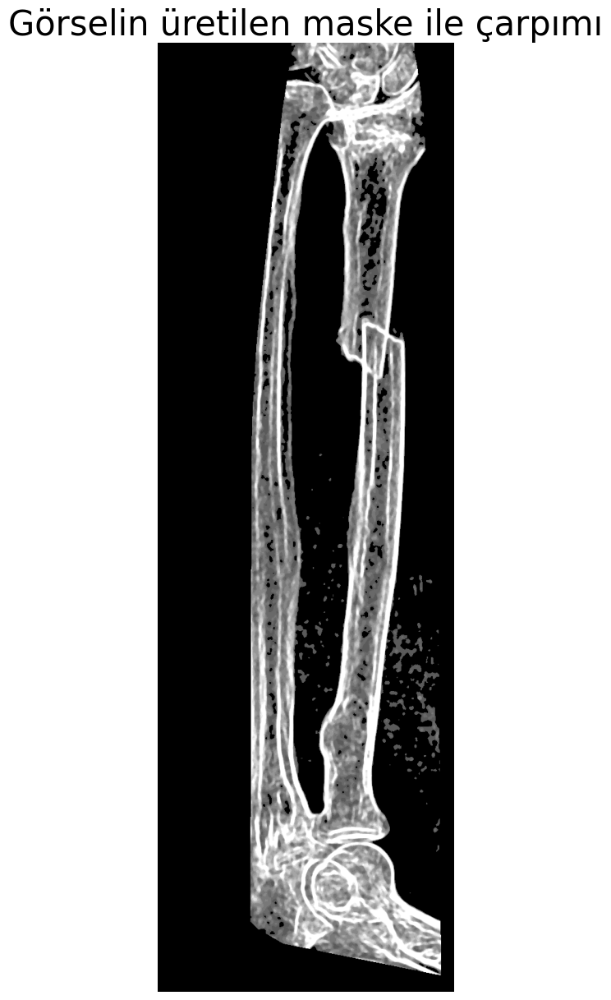

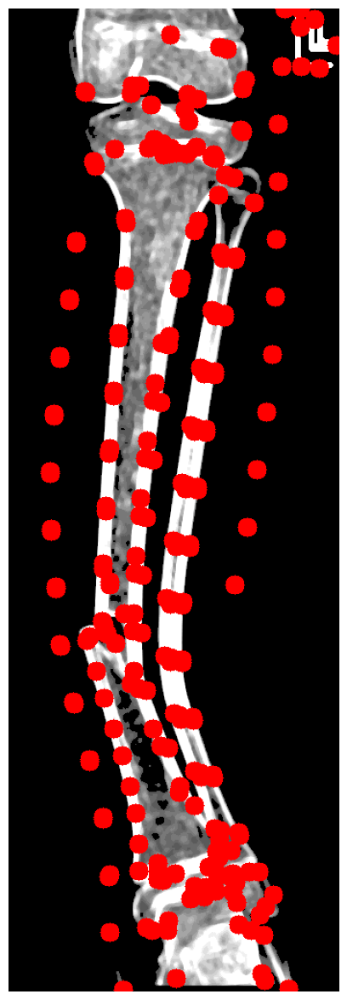

...

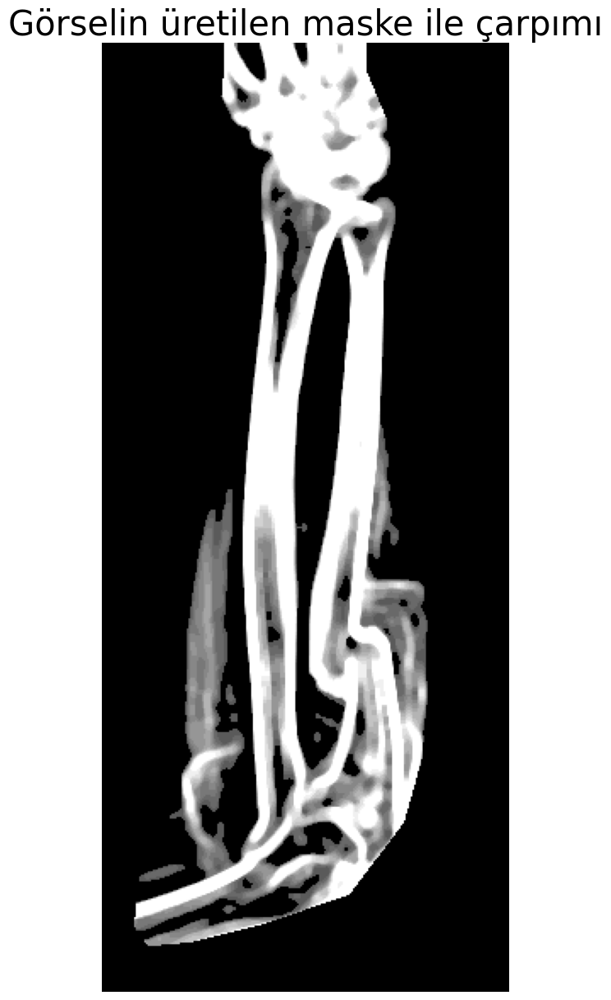

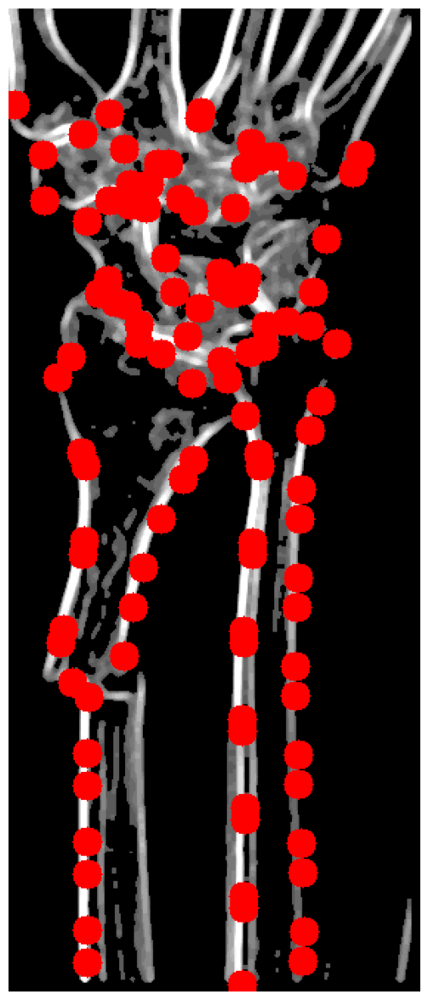

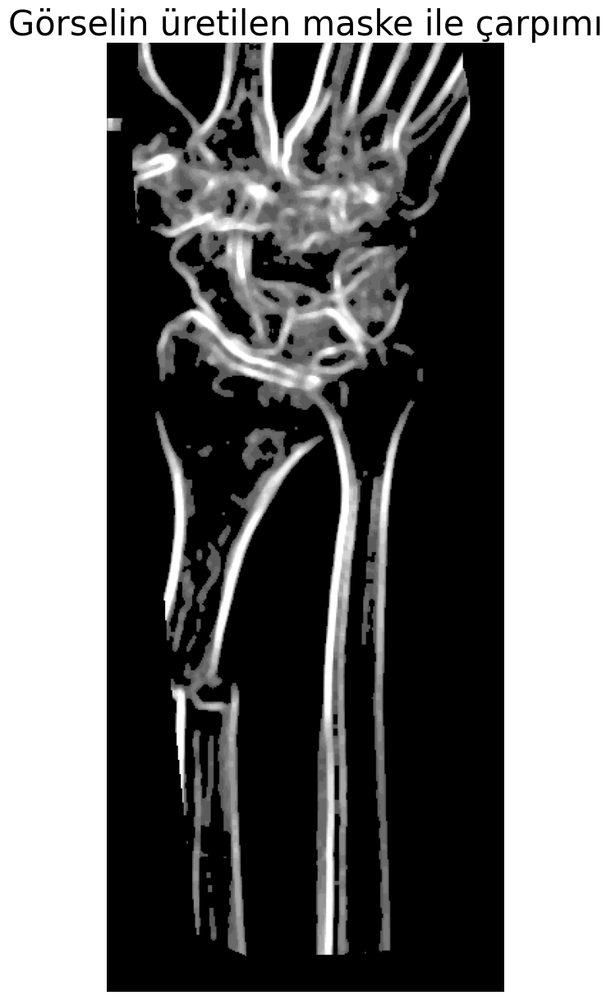

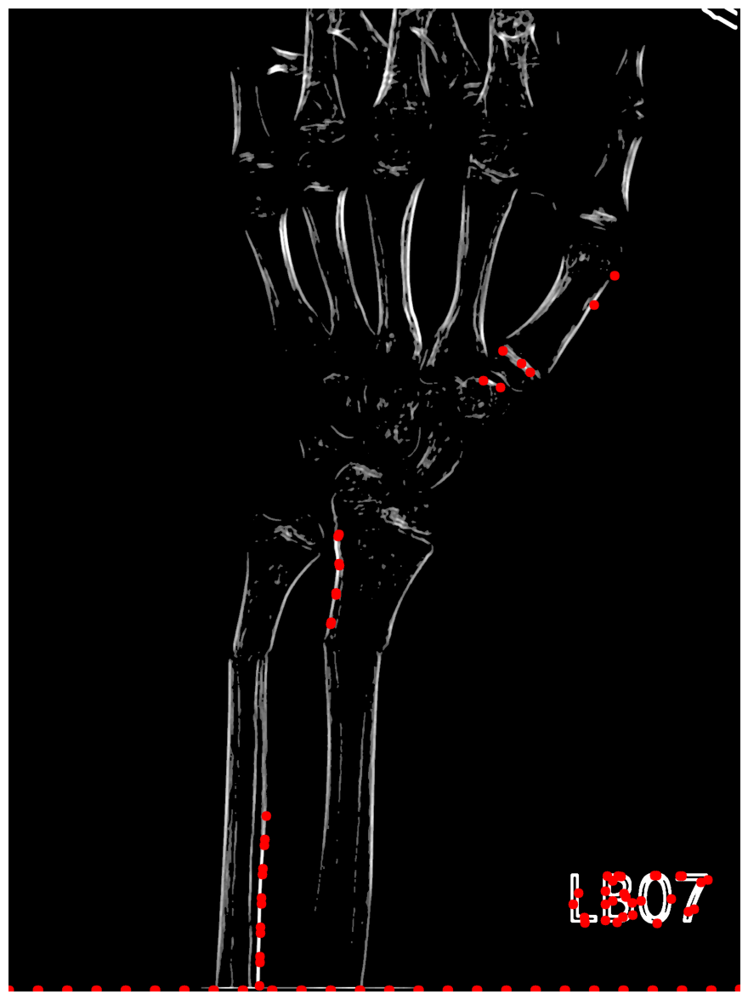

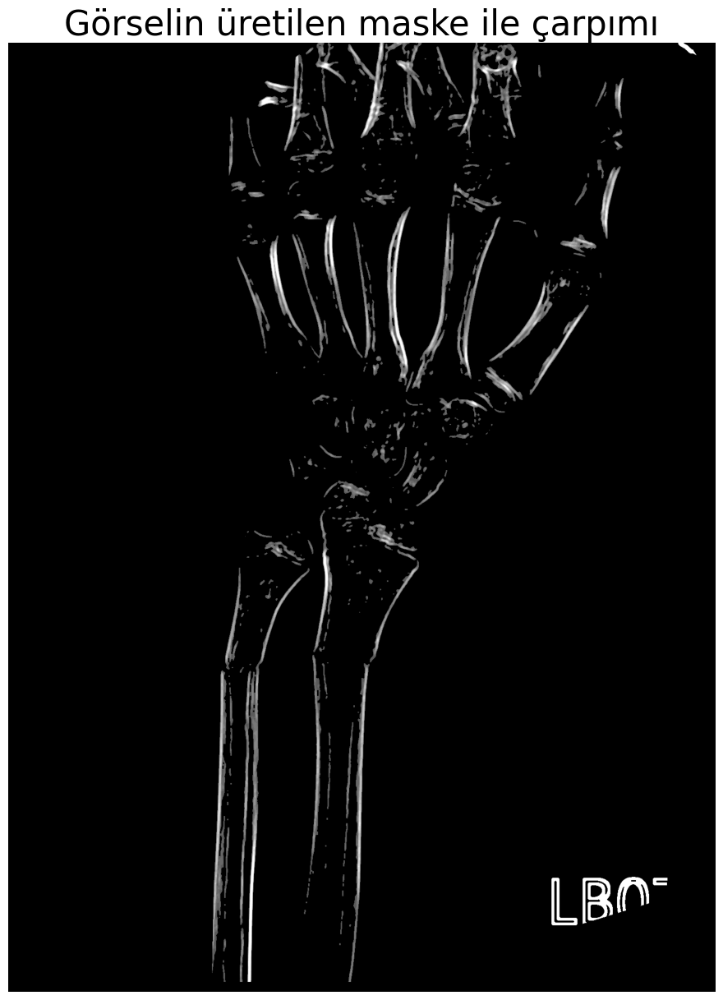

In [121]:
for i in range(0, 10): 
    img_path = f"DB/img{i}.png"
    label_path = f"DB/label{i}.png"

    test_img, test_label = GetImageLabel(img_path,label_path,draw=False)
    test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=60, draw=False)   # EdgePoints --> [p,2] --> (y,x)
    test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=50, draw=False)
    test_img_EdgeVecs = EdgePatchs2EdgeVecs(test_img_EdgePatchs, draw=False)
    TrueEdgePoints = Match(img_UniqueVecs, test_img_EdgeVecs, test_img_EdgePoints)

    img, test_img = process_image(img_path)
    test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2GRAY)

    Drawing(test_img, EdgePoints=TrueEdgePoints)

    # Kenar noktalarını al
    test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=100, draw=False)  # (y, x) formatında

    # Maskeyi uygula ve temizle
    masked_img, maske = ApplyConvexHullEdgeMaskWithCleanup(test_img, test_img_EdgePoints, radius=3, min_area=500)

    # Sonucu çiz
    Drawing(masked_img, title="Görselin üretilen maske ile çarpımı")

## Desen Kodlama

In [1]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import local_binary_pattern

# LBP ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Dosya yolları
images_folder = "DB/"  # Yüklenen img dosyalarının olduğu klasör
masks_folder = "DB/"   # Yüklenen label dosyalarının olduğu klasör
output_file = "all_keypoints.pkl"  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesini otomatik oluştur
num_images = 38  # Görüntü ve maske sayısı
file_names = [f"img{i}.png" for i in range(num_images)]
mask_names = [f"label{i}.png" for i in range(num_images)]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for img_file, mask_file in zip(file_names, mask_names):
    try:
        # Görüntü ve maskeyi yükle
        img_path = os.path.join(images_folder, img_file)
        mask_path = os.path.join(masks_folder, mask_file)
        xray_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {img_file}, {mask_file}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # İlgi bölgesine LBP uygula
        lbp = local_binary_pattern(region_of_interest, n_points, radius, METHOD)

        # LBP sonucunu normalize et
        lbp_normalized = cv2.normalize(lbp, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

        # SIFT nesnesi oluştur ve LBP üzerinden anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(lbp_normalized, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[img_file] = keypoints_list

        # Bilgi yazdır
        print(f"{img_file}: LBP ile tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {img_file}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


img0.png: LBP ile tespit edilen anahtar nokta sayısı: 1560
img1.png: LBP ile tespit edilen anahtar nokta sayısı: 4383
img2.png: LBP ile tespit edilen anahtar nokta sayısı: 1064
img3.png: LBP ile tespit edilen anahtar nokta sayısı: 610
img4.png: LBP ile tespit edilen anahtar nokta sayısı: 759
img5.png: LBP ile tespit edilen anahtar nokta sayısı: 4300
img6.png: LBP ile tespit edilen anahtar nokta sayısı: 6462
img7.png: LBP ile tespit edilen anahtar nokta sayısı: 349
img8.png: LBP ile tespit edilen anahtar nokta sayısı: 930
img9.png: LBP ile tespit edilen anahtar nokta sayısı: 3186
img10.png: LBP ile tespit edilen anahtar nokta sayısı: 347
img11.png: LBP ile tespit edilen anahtar nokta sayısı: 118
img12.png: LBP ile tespit edilen anahtar nokta sayısı: 647
img13.png: LBP ile tespit edilen anahtar nokta sayısı: 674
img14.png: LBP ile tespit edilen anahtar nokta sayısı: 137
img15.png: LBP ile tespit edilen anahtar nokta sayısı: 706
img16.png: LBP ile tespit edilen anahtar nokta sayısı: 371
i

Kaydedilen toplam anahtar nokta sayısı: 80303
Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): 15712
İyi eşleşme sayısı: 1185


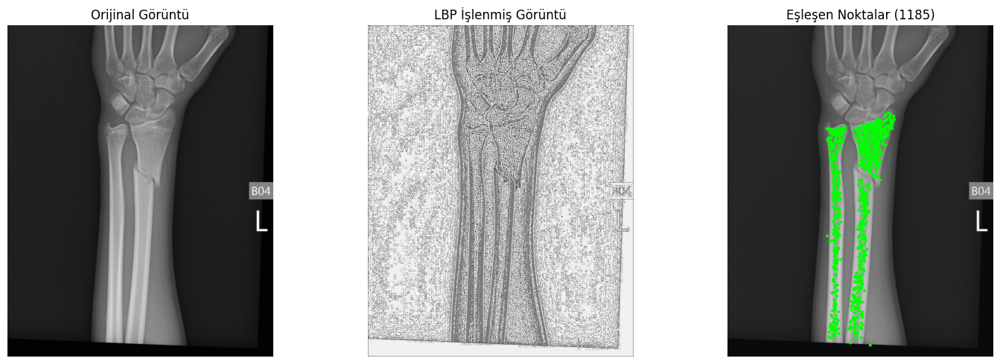

In [3]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt
import os

# LBP ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = "all_keypoints.pkl"  # Anahtar nokta dosyası aynı dizinde olmalı

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = "DB/img0.png"  # Yeni görüntü dosyasının adını düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# Yeni görüntüye LBP uygula
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunu normalize et
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni LBP görüntüsünden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher hazırlayın
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi uygulayarak iyi eşleşmeleri al
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Yeni görüntüde eşleşen noktaları çiz
if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]
    matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

# Görselleri yan yana göster
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# LBP ile işlenmiş görüntü
axs[1].imshow(lbp_normalized, cmap='gray')
axs[1].set_title("LBP İşlenmiş Görüntü")
axs[1].axis('off')

# Eşleşen anahtar noktalar
if len(good_matches) > 0:
    axs[2].imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    axs[2].set_title(f"Eşleşen Noktalar ({len(good_matches)})")
else:
    axs[2].imshow(new_image, cmap='gray')
    axs[2].set_title("Eşleşme Bulunamadı")
axs[2].axis('off')

plt.tight_layout()
plt.show()

İyi eşleşmelerin sayısı: 1182


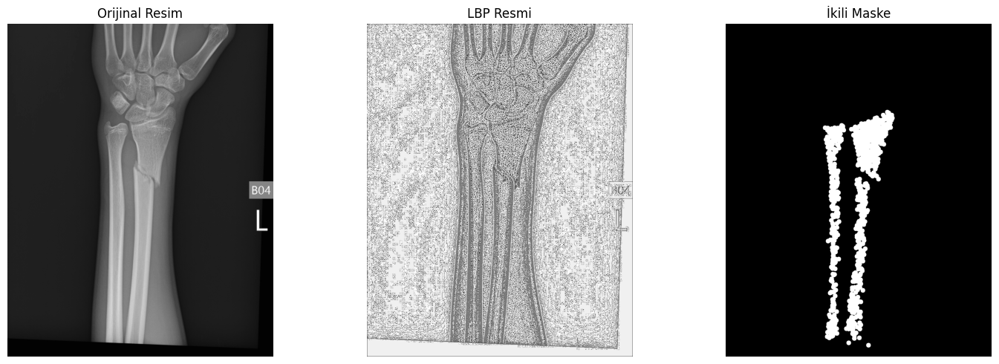

In [5]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = "all_keypoints.pkl"  # Dosya yolunuzu buraya girin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

# Yeni resmin yolu
new_image_path = "DB/img0.png"  # Dosya yolunuzu buraya girin

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı. Dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)  # Performans için ayarlandı
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Betimleyicilerin eşleştirilmesi
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulaması
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Eşleşen noktalara dayalı ikili maske oluşturma
mask = np.zeros_like(new_image, dtype=np.uint8)

if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    for pt in points_new:
        x, y = int(pt[0]), int(pt[1])
        # Maskeye noktaları ekleme
        cv2.circle(mask, (x, y), radius=8, color=255, thickness=-1)  # Her nokta için küçük daire

    # Görselleri gösterme
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.title("Orijinal Resim")
    plt.imshow(new_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("LBP Resmi")
    plt.imshow(lbp_normalized, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("İkili Maske")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


İyi eşleşmelerin sayısı: 1182


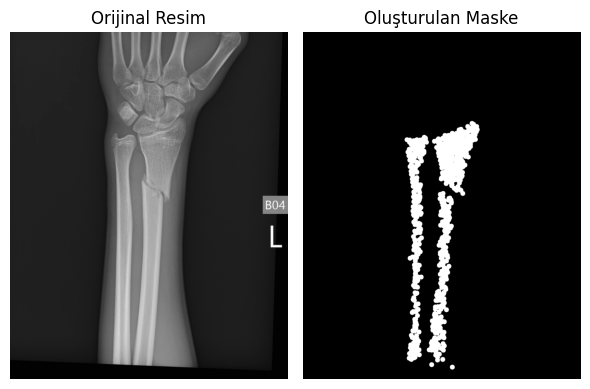

In [6]:
import os
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Anahtar noktalar dosyasının yolu
all_keypoints_file = "all_keypoints.pkl"  # Aynı dizinde olduğunu varsayıyoruz

# Anahtar noktalar dosyasını kontrol et
if not os.path.exists(all_keypoints_file):
    raise FileNotFoundError(f"Anahtar noktalar dosyası bulunamadı: {all_keypoints_file}")

# Anahtar noktalar dosyasını yükleme
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm anahtar noktaları ve betimleyicileri birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

# Yeni resim dosyasının yolu
new_image_path = "DB/img0.png"  # Dosya yolunuzu buraya girin

# Yeni resim dosyasını kontrol et
if not os.path.exists(new_image_path):
    raise FileNotFoundError(f"Yeni resim dosyası bulunamadı: {new_image_path}")

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim yüklenemedi. Dosya formatını veya içeriğini kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Betimleyicilerin eşleştirilmesi
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulaması
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Eşleşen noktalara dayalı ikili maske oluşturma
mask = np.zeros_like(new_image, dtype=np.uint8)

if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    for pt in points_new:
        x, y = int(pt[0]), int(pt[1])
        # Maskeye noktaları ekleme
        cv2.circle(mask, (x, y), radius=8, color=255, thickness=-1)  # Her nokta için küçük daire

    # Maskeyi gösterme
    plt.figure(figsize=(6, 6))
    plt.subplot(1, 2, 1)
    plt.title("Orijinal Resim")
    plt.imshow(new_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title("Oluşturulan Maske")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


Kaydedilen toplam anahtar nokta sayısı: 80303
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 15712
İyi eşleşmelerin sayısı: 1182
Intersection over Union (IoU): 0.8132


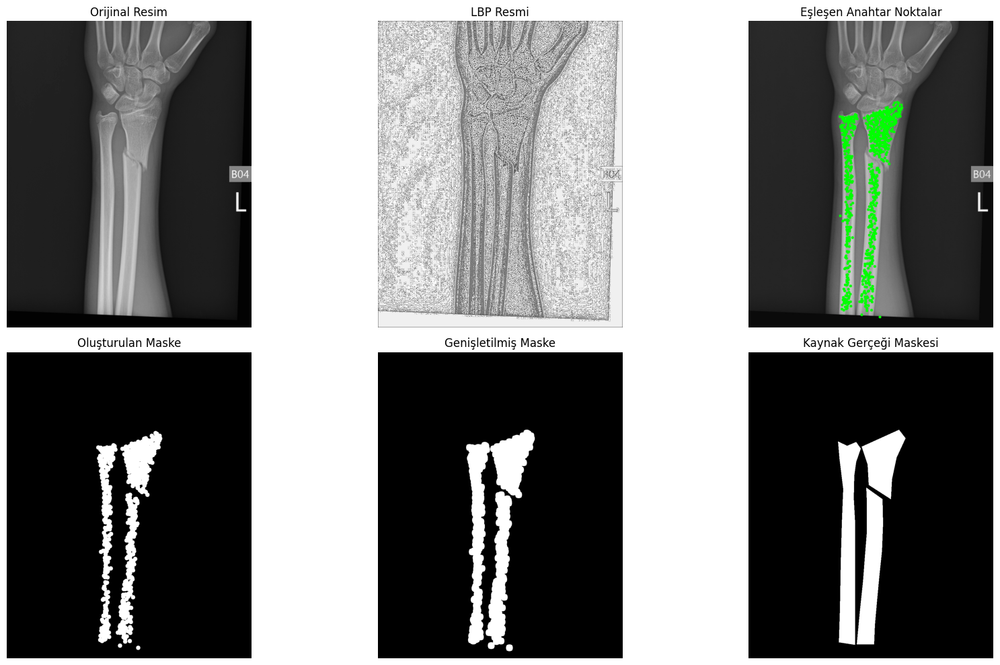

In [7]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = "all_keypoints.pkl"  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resim ve kaynak gerçeği maskesi yolları
new_image_path = "DB/img0.png"  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = "DB/label0.png"  # Kaynak gerçeği maskesi

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.60 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    for pt in points_new:
        x, y = int(pt[0]), int(pt[1])
        # Maskeye noktaları ekleme
        cv2.circle(mask, (x, y), radius=7, color=255, thickness=-1)  # Her nokta için küçük daire

    kernel = np.ones((5, 5), np.uint8)
    dilated_mask = cv2.dilate(mask, kernel, iterations=2)

    intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0
    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Tüm adımları görselleştirme
    plt.figure(figsize=(18, 10))
    images = [new_image, lbp_normalized, matched_image, mask, dilated_mask, ground_truth_mask]
    titles = [
        "Orijinal Resim",
        "LBP Resmi",
        "Eşleşen Anahtar Noktalar",
        "Oluşturulan Maske",
        "Genişletilmiş Maske",
        "Kaynak Gerçeği Maskesi"
    ]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")

Kaydedilen toplam anahtar nokta sayısı: 80303
Resim 0: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 15712
Resim 0: İyi eşleşmelerin sayısı: 1182
Resim 0: Intersection over Union (IoU): 0.7989


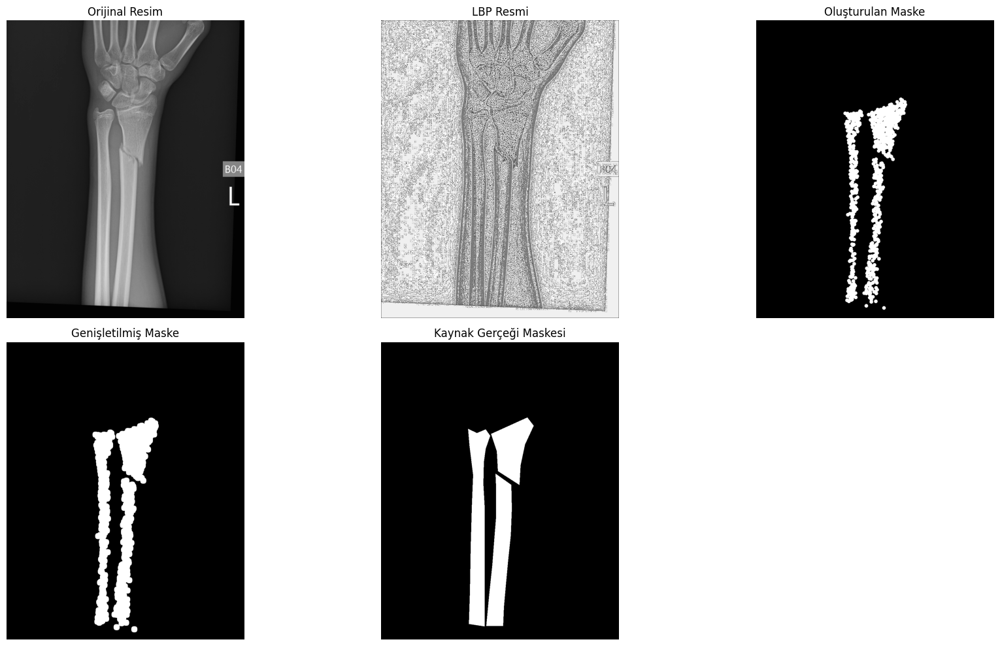

Resim 1: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 14189
Resim 1: İyi eşleşmelerin sayısı: 3775
Resim 1: Intersection over Union (IoU): 0.9343


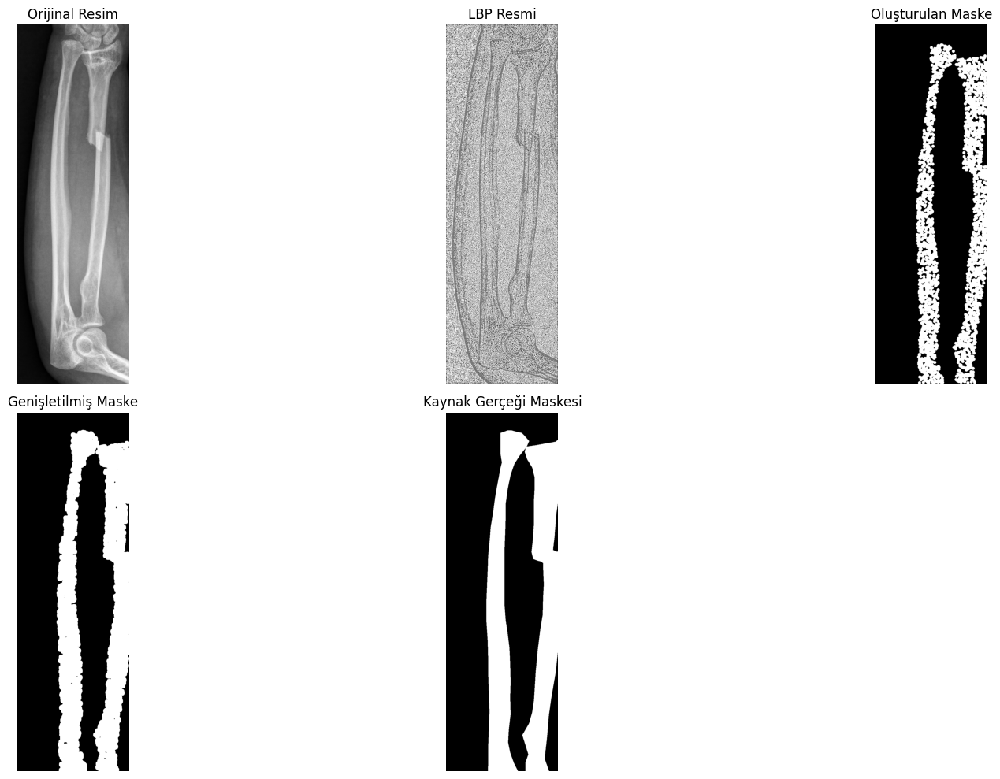

Resim 2: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5318
Resim 2: İyi eşleşmelerin sayısı: 730
Resim 2: Intersection over Union (IoU): 0.8161


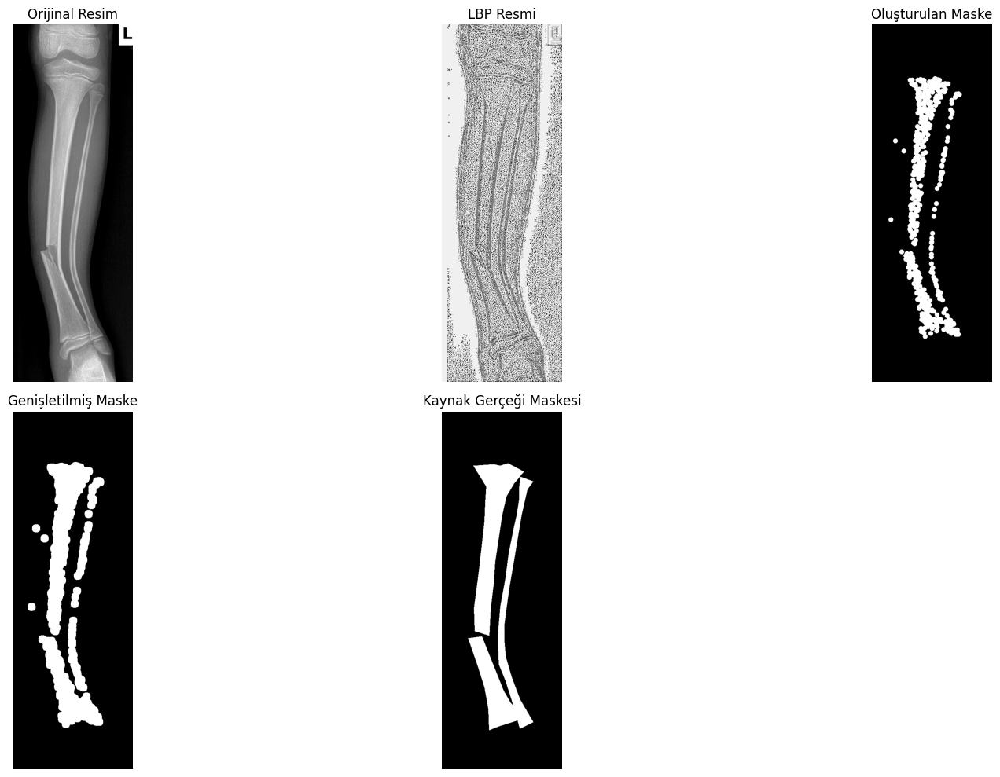

Resim 3: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 3473
Resim 3: İyi eşleşmelerin sayısı: 841
Resim 3: Intersection over Union (IoU): 0.7814


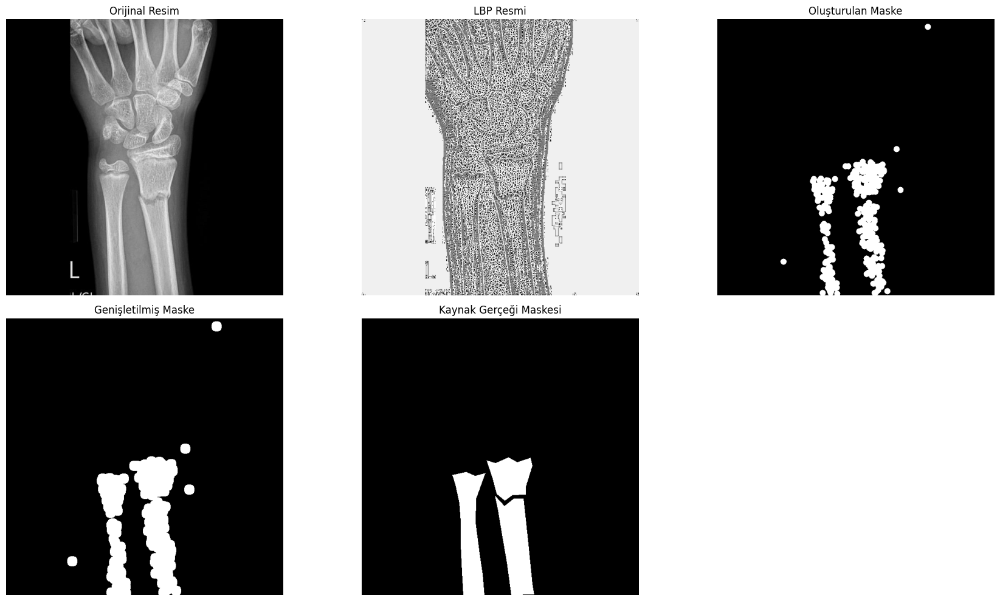

Resim 4: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 7523
Resim 4: İyi eşleşmelerin sayısı: 477
Resim 4: Intersection over Union (IoU): 0.8180


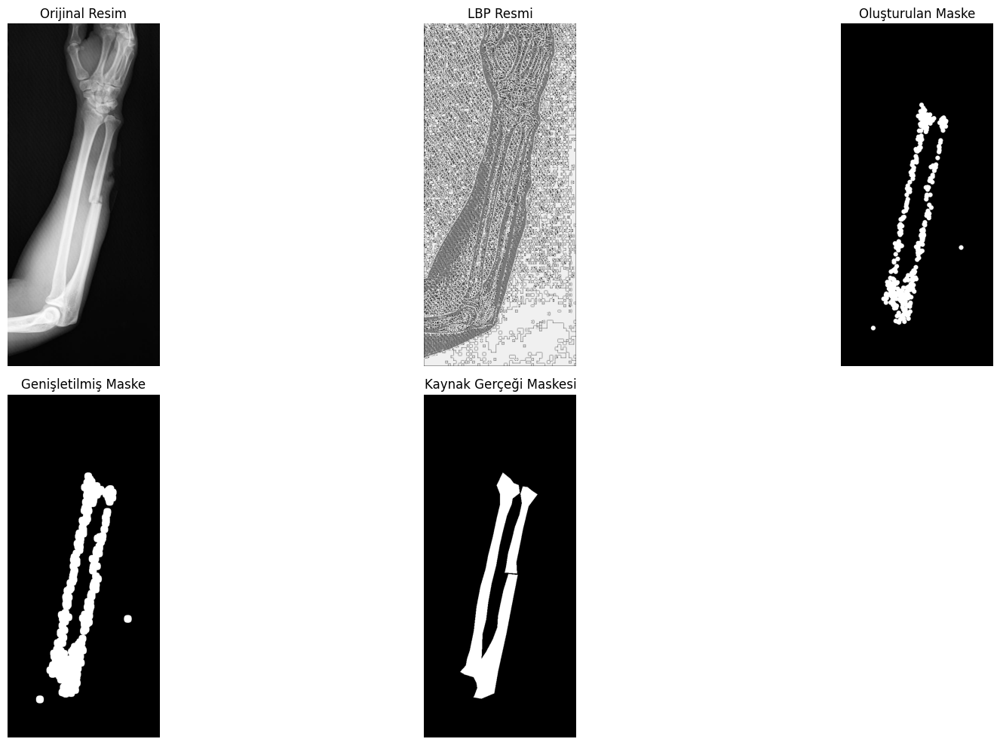

Resim 5: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 26682
Resim 5: İyi eşleşmelerin sayısı: 3478
Resim 5: Intersection over Union (IoU): 0.8899


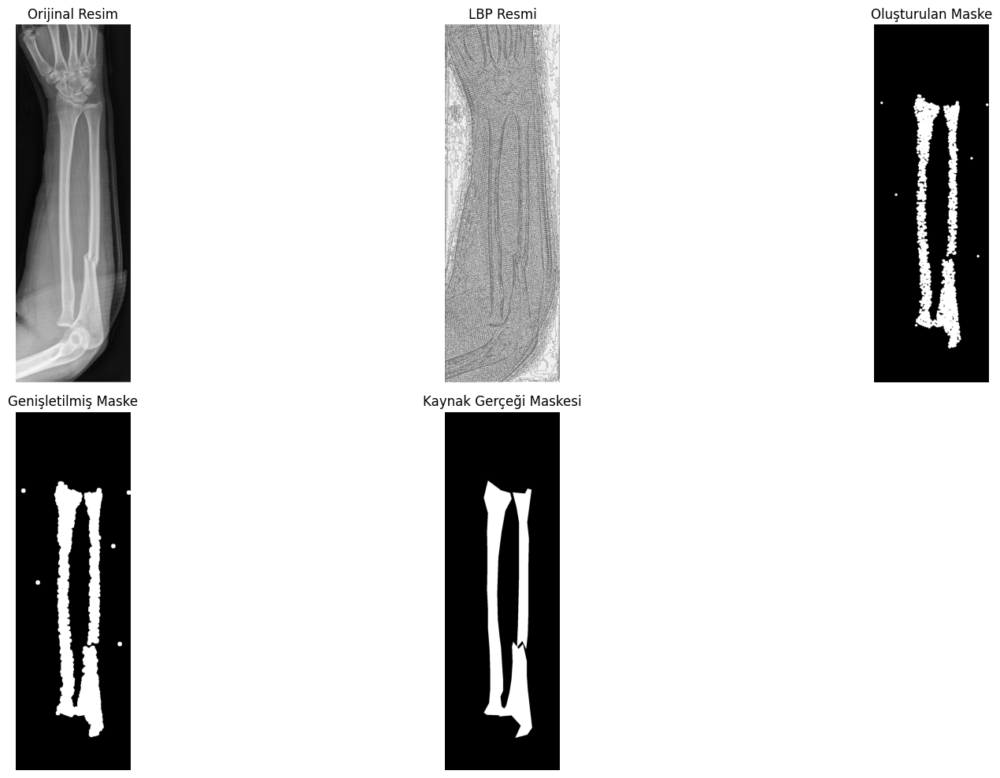

Resim 6: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 34995
Resim 6: İyi eşleşmelerin sayısı: 5485
Resim 6: Intersection over Union (IoU): 0.9274


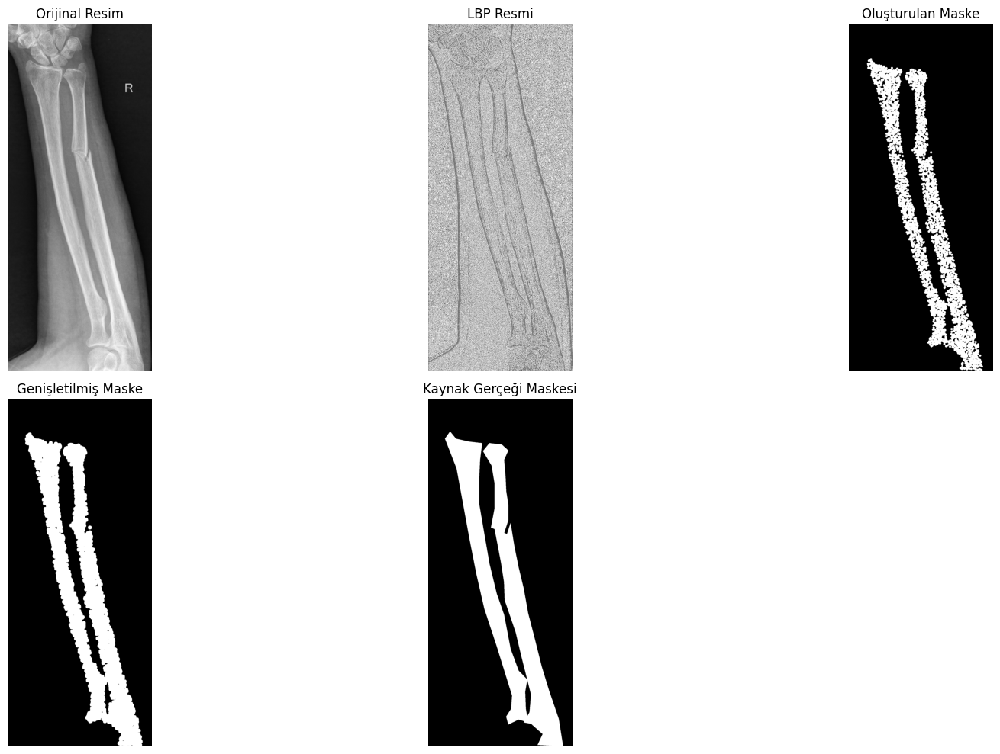

Resim 7: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 1979
Resim 7: İyi eşleşmelerin sayısı: 175
Resim 7: Intersection over Union (IoU): 0.6528


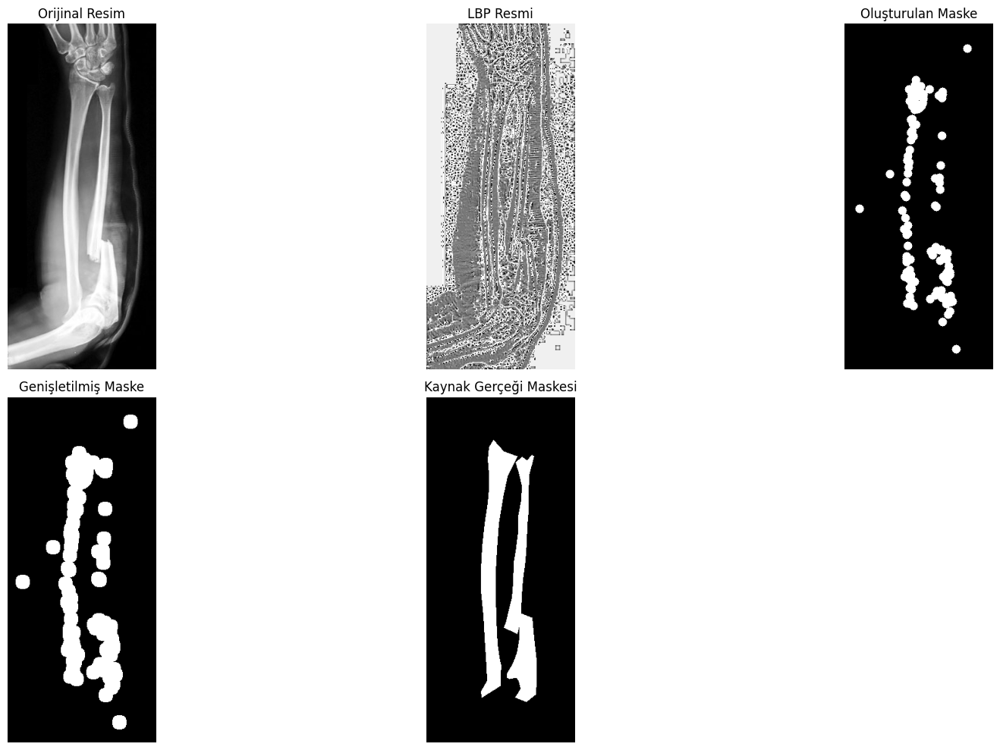

Resim 8: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 3420
Resim 8: İyi eşleşmelerin sayısı: 674
Resim 8: Intersection over Union (IoU): 0.8191


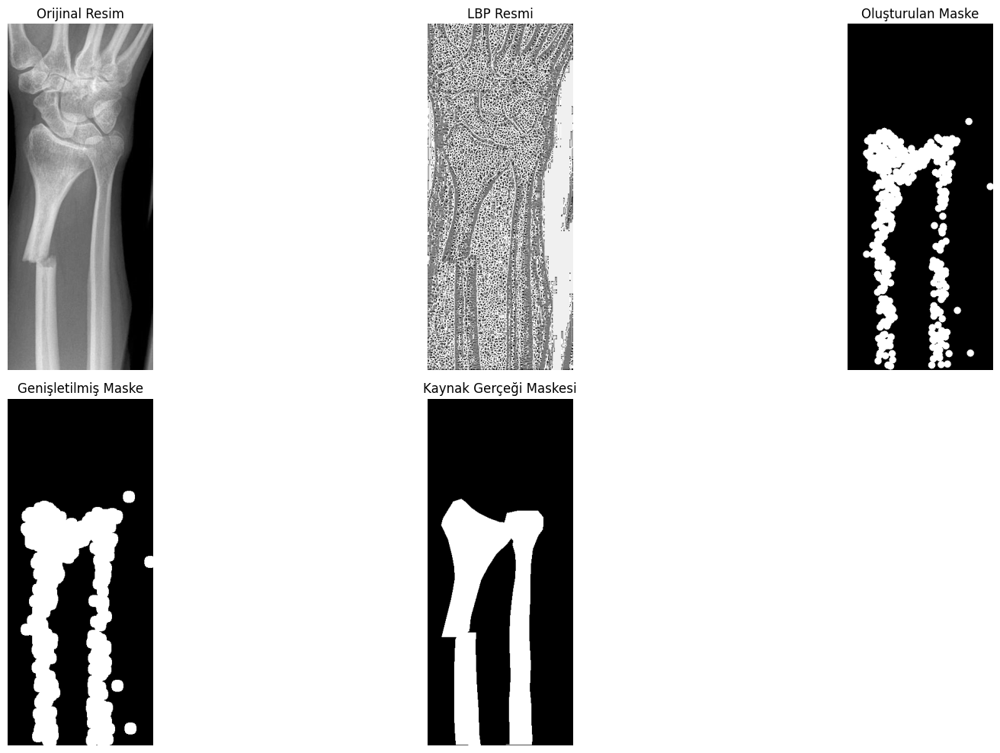

Resim 9: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 56506
Resim 9: İyi eşleşmelerin sayısı: 2585
Resim 9: Intersection over Union (IoU): 0.8919


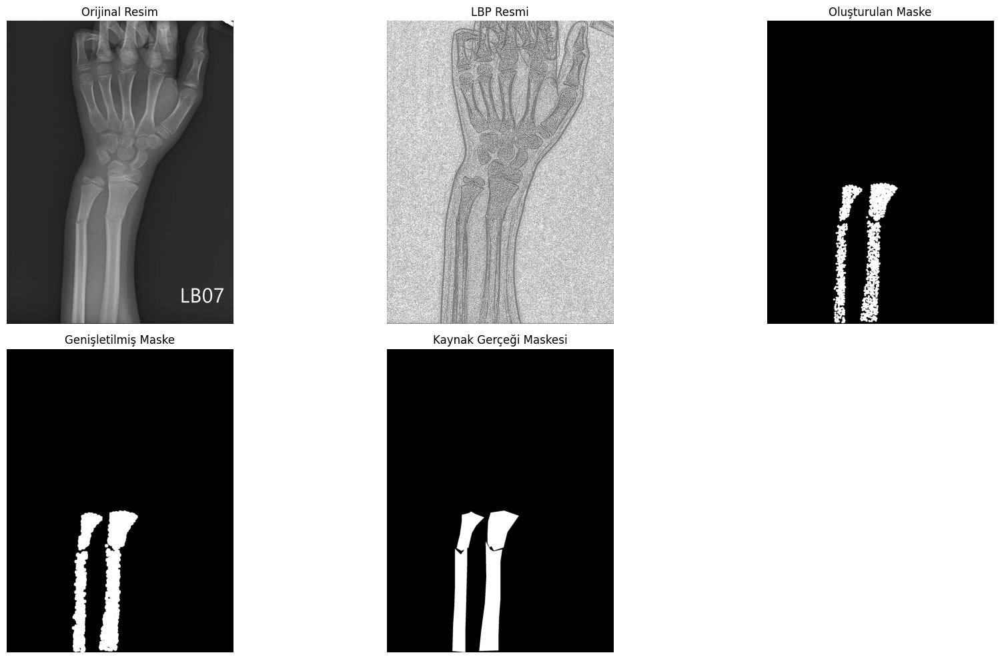

In [8]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 2
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = "all_keypoints.pkl"  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# 10 farklı resim üzerinde işlem yapma
for i in range(10):
    new_image_path = f"DB/img{i}.png"  # Yeni resim yolu
    ground_truth_mask_path = f"DB/label{i}.png"  # Kaynak gerçeği maskesi yolu

    # Yeni resmin yüklenmesi
    new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
    if new_image is None:
        print(f"Resim yüklenemedi: {new_image_path}")
        continue

    # Kaynak gerçeği maskesinin yüklenmesi
    ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
    if ground_truth_mask is None:
        print(f"Kaynak gerçeği maskesi yüklenemedi: {ground_truth_mask_path}")
        continue

    # Yeni resme LBP uygulanması
    lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

    # LBP sonucunun normalizasyonu
    lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

    # SIFT nesnesi oluşturma
    sift = cv2.SIFT_create()

    # Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
    keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

    print(f"Resim {i}: Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

    # FLANN matcher ayarları
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
    search_params = dict(checks=200)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # KNN ile betimleyicileri eşleştirme
    matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

    # Lowe oran testi uygulanması
    good_matches = []
    for m, n in matches:
        if m.distance < 0.60 * n.distance:
            good_matches.append(m)

    print(f"Resim {i}: İyi eşleşmelerin sayısı: {len(good_matches)}")

    if len(good_matches) > 0:
        mask = np.zeros(new_image.shape, dtype=np.uint8)
        points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

        for pt in points_new:
            x, y = int(pt[0]), int(pt[1])
            # Maskeye noktaları ekleme
            cv2.circle(mask, (x, y), radius=7, color=255, thickness=-1)

        kernel = np.ones((5, 5), np.uint8)
        dilated_mask = cv2.dilate(mask, kernel, iterations=2)

        intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
        union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
        iou = intersection / union if union > 0 else 0
        print(f"Resim {i}: Intersection over Union (IoU): {iou:.4f}")

        # Tüm adımları görselleştirme
        plt.figure(figsize=(18, 10))
        images = [new_image, lbp_normalized, mask, dilated_mask, ground_truth_mask]
        titles = [
            "Orijinal Resim",
            "LBP Resmi",
            "Oluşturulan Maske",
            "Genişletilmiş Maske",
            "Kaynak Gerçeği Maskesi"
        ]

        for j, (img, title) in enumerate(zip(images, titles)):
            plt.subplot(2, 3, j + 1)
            plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
            plt.title(title)
            plt.axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print(f"Resim {i}: Hiçbir iyi eşleşme bulunamadı.")
